In [1]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('../')


import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random 
import scipy
import seaborn as sns

from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from torch.utils.data import DataLoader, TensorDataset,ConcatDataset
from scipy.stats import zscore

from sklearn.neighbors import KDTree
from coral import coral_main, VisCoxDataset, utils, utils_exp, utils_simu
from scipy.spatial import cKDTree

import scanpy as sc
import anndata
import torch

In [2]:
adata = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/Data_SpatialGlue/Dataset3_Mouse_Thymus1/adata_thymus1_annotation.h5ad')
codex_adata =  sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/Data_SpatialGlue/Dataset3_Mouse_Thymus1/adata_ADT.h5ad')
visium_adata =  sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/Data_SpatialGlue/Dataset3_Mouse_Thymus1/adata_RNA.h5ad')

codex_adata = codex_adata[adata.obs_names,:]
visium_adata = visium_adata[adata.obs_names,:]

/hpc/mydata/siyu.he/Siyu_projects/Coral_project/notebooks/../coral/utils_simu.py:214: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_, resolution=res,random_state=42)


2
1
7
6
3
0
4
5


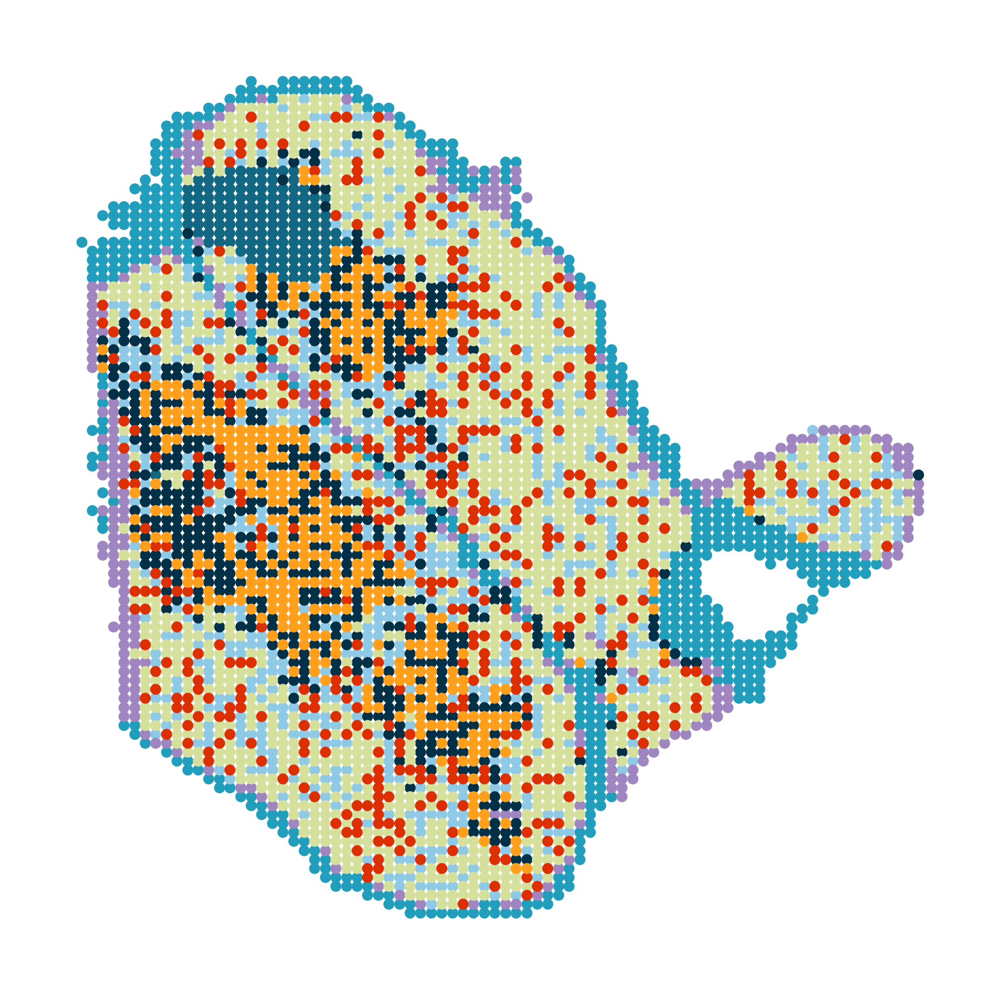

In [3]:
codex_adata_copy = utils_simu.plot_pca_cluster(codex_adata,
                               res=0.62,
                               size =1,
color_list = [
'#219ebc',
'#8ecae6',
'#126782',
'#9f86c0', 
'#023047',                                  
'#d4e09b', 
'#dc2f02',
'#ff9f1c',


'#dc2f02',
'#9d0208',
'#f08080',
'#f94144',
'#f3722c',
'#f8961e',
'#f9c74f',
'#90be6d',
'#43aa8b',
'#577590',  
'#226CE0',
'#534B62'
],
                            figsize=(3,3),
                            legd = False,#True,
                            invert_yaxis=True,                   
                            return_ = True,
                            axis_=False,
                              )

Connective tissue capsule (fibroblast, RBC, myeloid)
Outer cortex region 3 (DN T, DP T,cTEC)
Middle cortex region 2 (DN T, DP T,cTEC)
Medulla (SP T, mTEC, DC)
Subcapsular zone (DN T)
Inner cortex region 1 (DN T, DP T, cTEC)
Connective tissue capsule (fibroblast)
Corticomedullary junction (CMJ)


(8724.0, 17414.0, -20835.0, -10605.0)

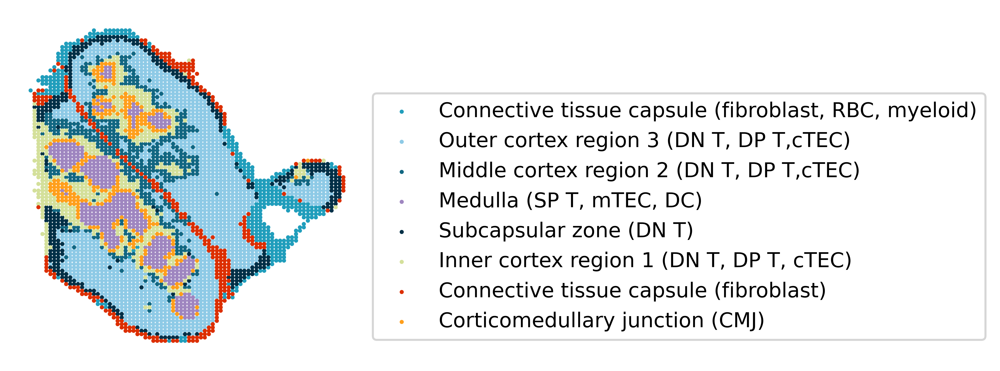

In [4]:
color_list = [
'#219ebc',
'#8ecae6',
'#126782',
'#9f86c0', 
'#023047',                                  
'#d4e09b', 
'#dc2f02',
'#ff9f1c',


'#dc2f02',
'#9d0208',
'#f08080',
'#f94144',
'#f3722c',
'#f8961e',
'#f9c74f',
'#90be6d',
'#43aa8b',
'#577590',  
'#226CE0',
'#534B62'
]
fig, ax = plt.subplots(1,1,figsize=(3,3),dpi=800)
for j,i in enumerate(adata.obs['Annotation'].unique()):
    print(i)
    plt.scatter(adata.obsm['spatial'][adata.obs['Annotation']==i,0],
                adata.obsm['spatial'][adata.obs['Annotation']==i,1],
                s=1,
                color = color_list[j]
               )
plt.legend(adata.obs['Annotation'].unique(),bbox_to_anchor=(1.01,0.8))
plt.axis('off') 
#plt.gca().invert_yaxis()

In [6]:
sc.tl.umap(codex_adata_copy,min_dist=0.5) 

Connective tissue capsule (fibroblast, RBC, myeloid)
Outer cortex region 3 (DN T, DP T,cTEC)
Middle cortex region 2 (DN T, DP T,cTEC)
Medulla (SP T, mTEC, DC)
Subcapsular zone (DN T)
Inner cortex region 1 (DN T, DP T, cTEC)
Connective tissue capsule (fibroblast)
Corticomedullary junction (CMJ)


(-0.4324758857488633,
 16.043352028727533,
 0.4330672591924667,
 12.838846209645272)

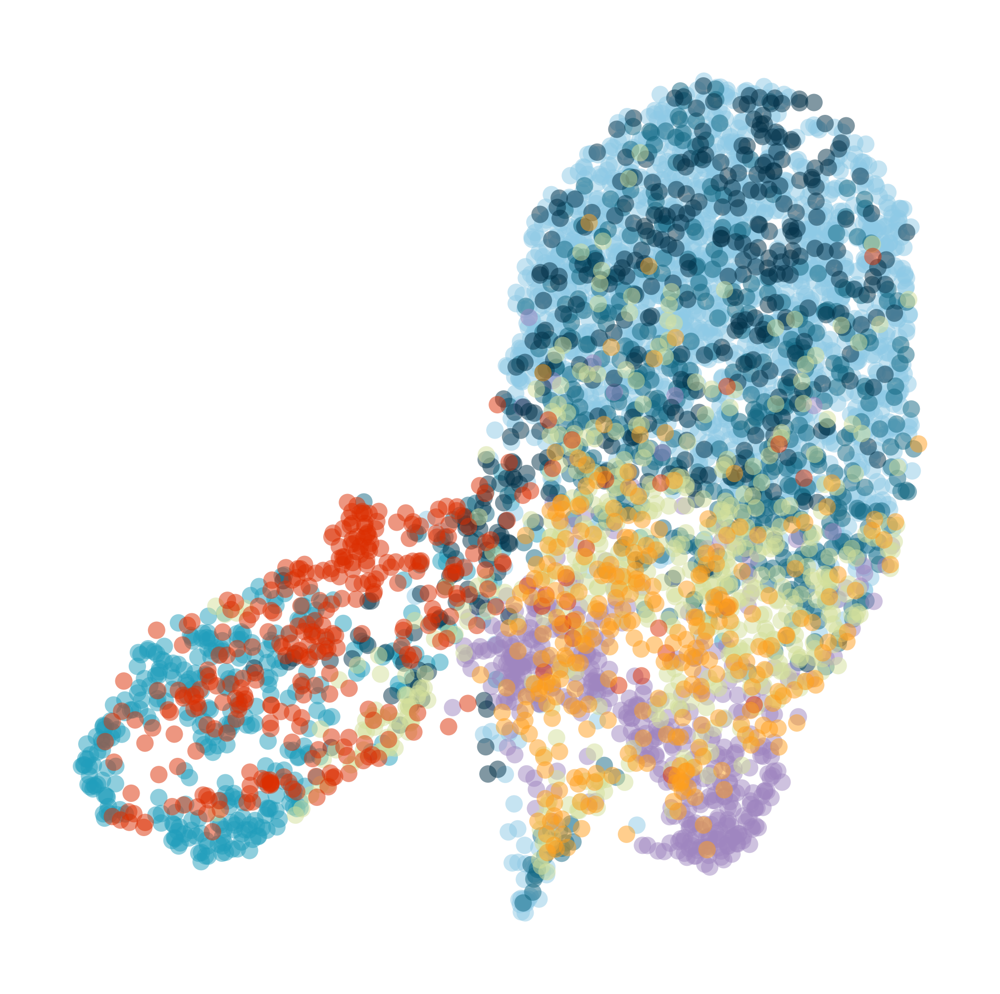

In [7]:

fig, ax = plt.subplots(1,1,figsize=(3,3),dpi=800)
for j,i in enumerate(adata.obs['Annotation'].unique()):
    print(i)
    plt.scatter(codex_adata_copy.obsm['X_umap'][adata.obs['Annotation']==i,0],
                codex_adata_copy.obsm['X_umap'][adata.obs['Annotation']==i,1],
                s=10,
                edgecolor='none',
                color = color_list[j],
                alpha = 0.5,
               )
plt.axis('off') 
#plt.yticks([])

(-0.6150846987962724,
 16.061516037583353,
 -1.510948967933655,
 11.053934407234191)

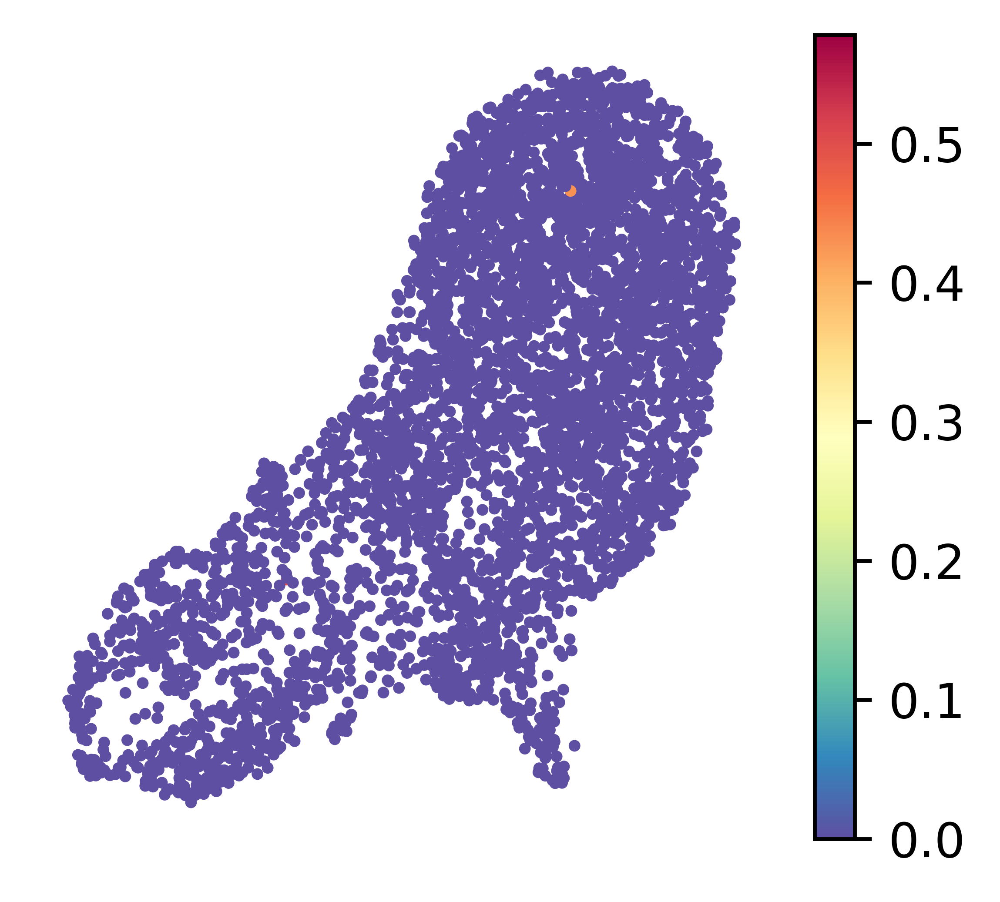

In [8]:
fig, ax = plt.subplots(1,1,figsize=(3.4,3),dpi=800)
g = plt.scatter(codex_adata_copy.obsm['X_umap'][:,0],
                codex_adata_copy.obsm['X_umap'][:,1],
                s=2,
                c = codex_adata_copy[:,'Mouse-CD304-Neuropilin-1'].to_df().values,
                cmap = 'Spectral_r',
                #vmin=2,
                #vmax=7.8
               )
plt.colorbar(g)
plt.axis('off') 
#plt.yticks([])

(-0.6150846987962724,
 16.061516037583353,
 -1.510948967933655,
 11.053934407234191)

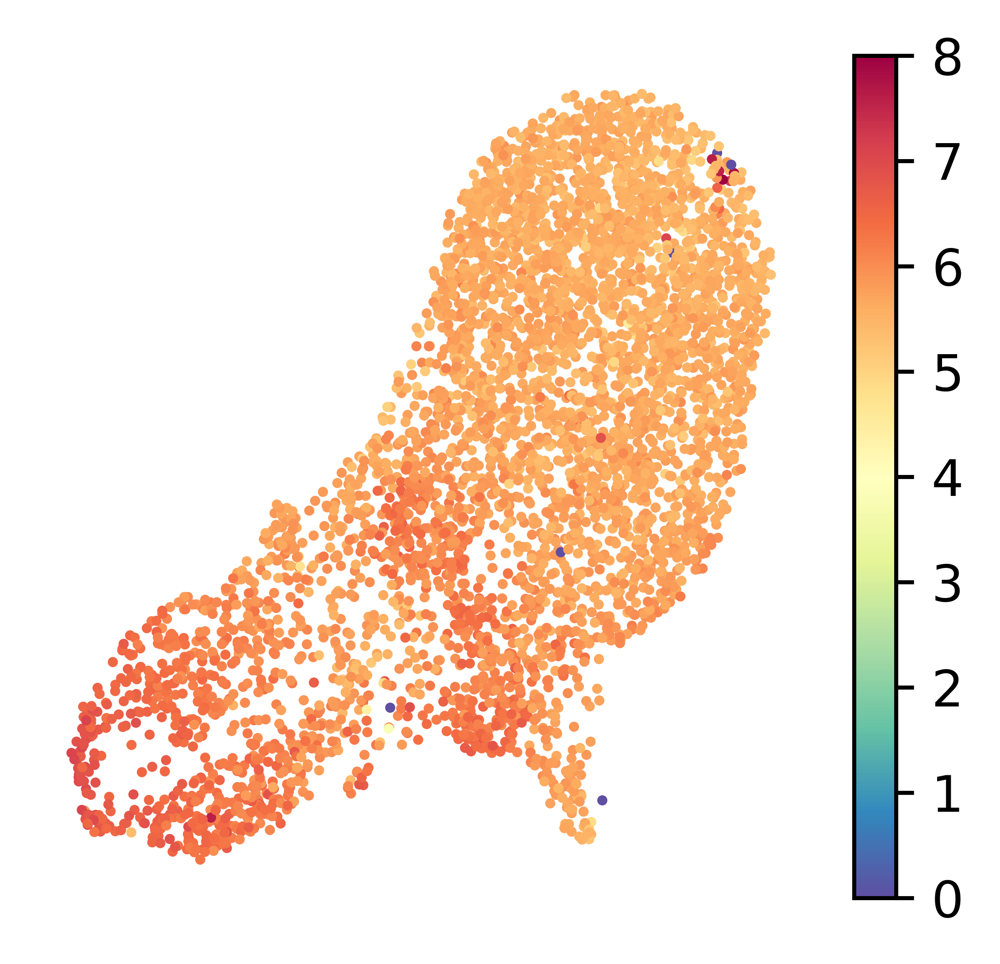

In [9]:
fig, ax = plt.subplots(1,1,figsize=(3.4,3),dpi=800)
g = plt.scatter(codex_adata_copy.obsm['X_umap'][:,0],
                codex_adata_copy.obsm['X_umap'][:,1],
                s=1,
                c = codex_adata_copy[:,'Mouse-CD3'].to_df().values,
                cmap = 'Spectral_r',
                vmin=0,
                vmax=8
               )
plt.colorbar(g)
plt.axis('off') 
#plt.yticks([])

(-0.6150846987962724,
 16.061516037583353,
 -1.510948967933655,
 11.053934407234191)

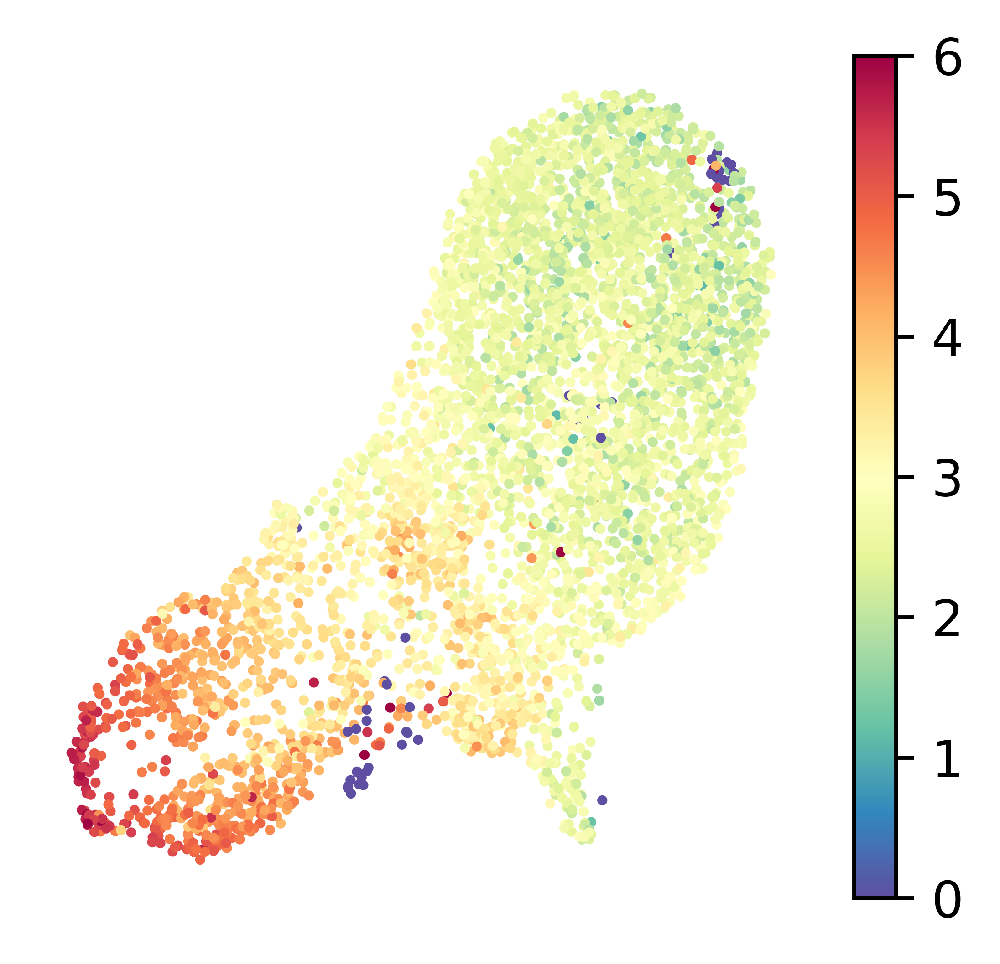

In [10]:
fig, ax = plt.subplots(1,1,figsize=(3.4,3),dpi=800)
g = plt.scatter(codex_adata_copy.obsm['X_umap'][:,0],
                codex_adata_copy.obsm['X_umap'][:,1],
                s=1,
                c = codex_adata_copy[:,'Mouse-CD19'].to_df().values,
                cmap = 'Spectral_r',
                vmin=0,
                vmax=6
                
               )
plt.colorbar(g)
plt.axis('off') 
#plt.yticks([])

In [11]:
codex_adata_copy.var_names

Index(['Mouse-CD8a', 'Mouse-CD4', 'Mouse-CD68', 'Mouse-CD29', 'Mouse-CD3',
       'Mouse-CD19', 'Mouse-CD31-Pecam', 'Rat-IgG2b', 'Mouse-CD38',
       'Mouse-CD45R-B220', 'Mouse-IgG2a', 'Mouse-F480', 'Mouse-CD169',
       'Mouse-IgD', 'Mouse-CD140a', 'Mouse-CX3CR1', 'Mouse-CD163',
       'Mouse-CD304-Neuropilin-1', 'Mouse-Ly-6C', 'Mouse-CD226-DNAM-1',
       'Mouse-P2RY12', 'Mouse-P2X7R', 'Human-CD8', 'Mouse-CD14', 'Mouse-CXCR4',
       'Mouse-CD79b-Igb', 'Mouse-CD335-NKp46', 'Ms-Hu-CD11b', 'Mouse-CD44',
       'Mouse-IgG1', 'Human-CD11c', 'Human-CD56', 'Mouse-IgG2b', 'Human-IgG',
       'Mouse-CD88-C5aR', 'Mouse-CD5', 'Human-PD-1', 'Mouse-BST-1',
       'Human-CD3', 'Mouse-CD90-2', 'Mouse-Ly-6G', 'Human-CD20', 'Human-CD11b',
       'Human-CD19', 'Mouse-CD11c', 'Mouse-IgM', 'Mouse-CD40', 'Rat-IgG2a',
       'Human-PD-L1', 'Mouse-CD71', 'Human-CD163'],
      dtype='object')

(-0.6150846987962724,
 16.061516037583353,
 -1.510948967933655,
 11.053934407234191)

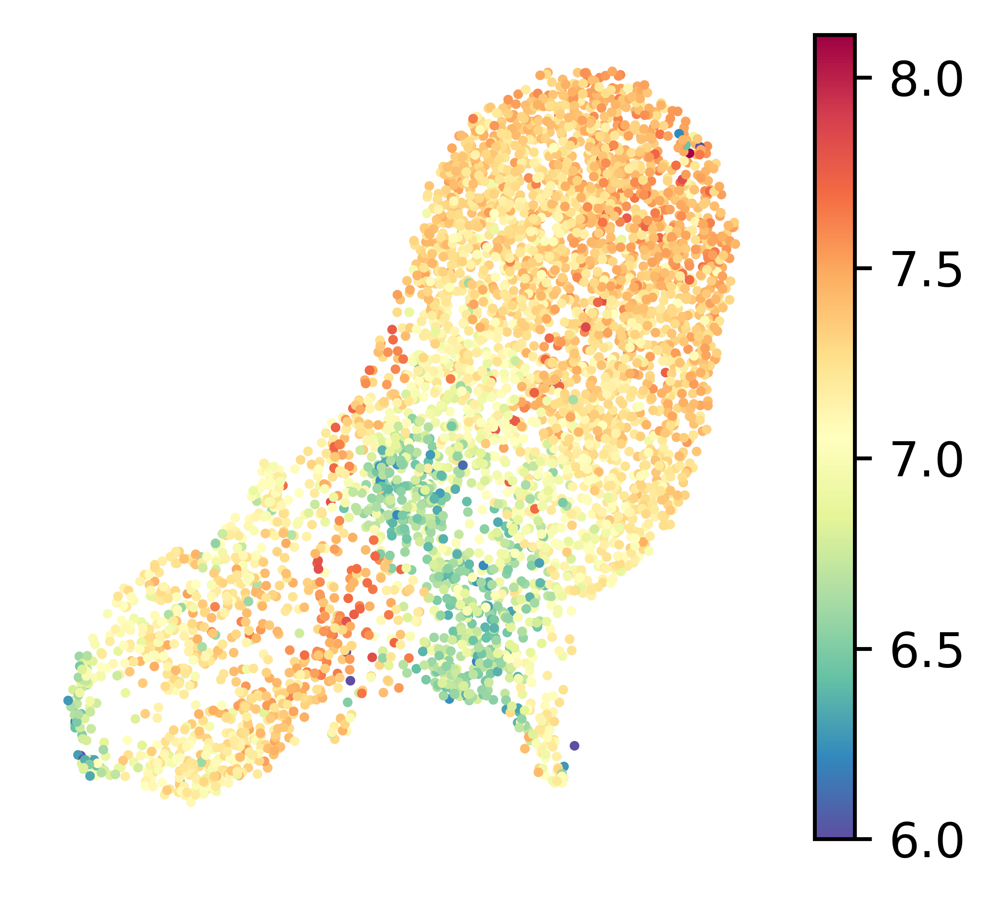

In [12]:
fig, ax = plt.subplots(1,1,figsize=(3.4,3),dpi=800)
g = plt.scatter(codex_adata_copy.obsm['X_umap'][:,0],
                codex_adata_copy.obsm['X_umap'][:,1],
                s=1,
                c = codex_adata_copy[:,'Mouse-CD8a'].to_df().values,
                cmap = 'Spectral_r',
                vmin=6,
                #vmax=7.8
               )
plt.colorbar(g)
plt.axis('off') 
#plt.yticks([])

(-0.6150846987962724,
 16.061516037583353,
 -1.510948967933655,
 11.053934407234191)

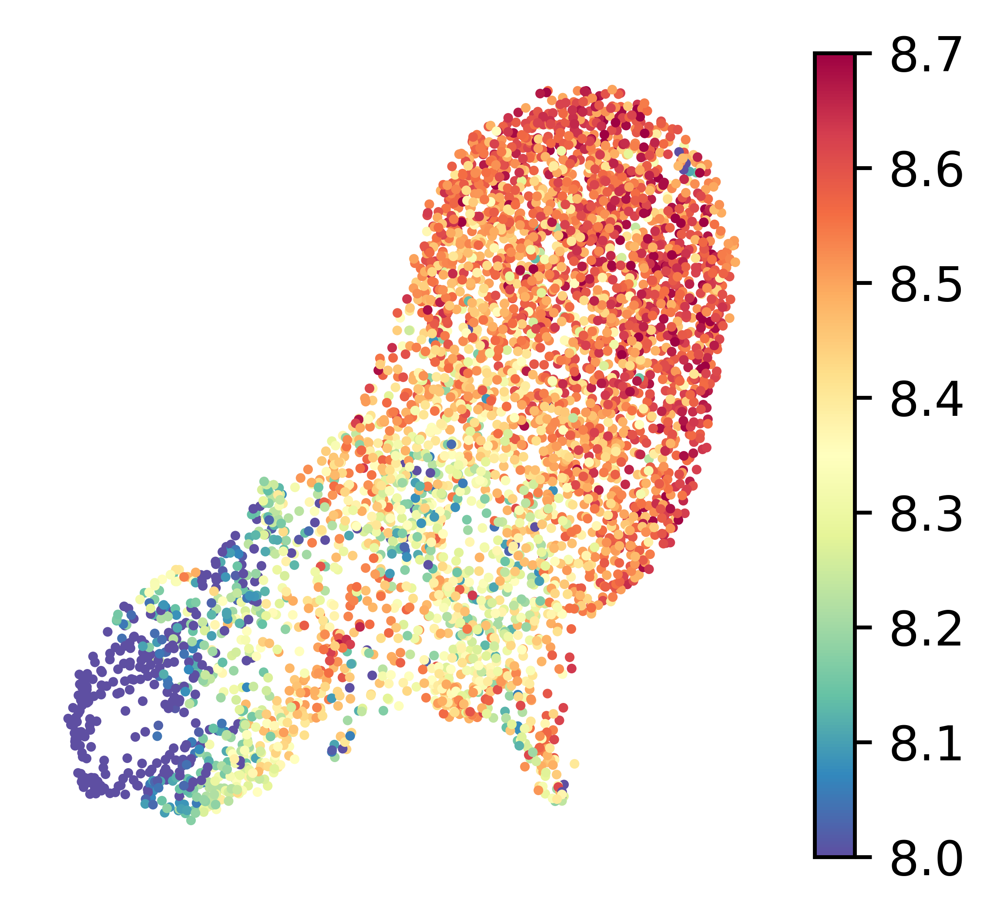

In [13]:
fig, ax = plt.subplots(1,1,figsize=(3.4,3),dpi=800)
g = plt.scatter(codex_adata_copy.obsm['X_umap'][:,0],
                codex_adata_copy.obsm['X_umap'][:,1],
                s=1,
                c = codex_adata_copy[:,'Mouse-CD4'].to_df().values,
                cmap = 'Spectral_r',
                vmin=8,
                vmax=8.7
               )
plt.colorbar(g)
plt.axis('off') 
#plt.yticks([])

(-0.6150846987962724,
 16.061516037583353,
 -1.510948967933655,
 11.053934407234191)

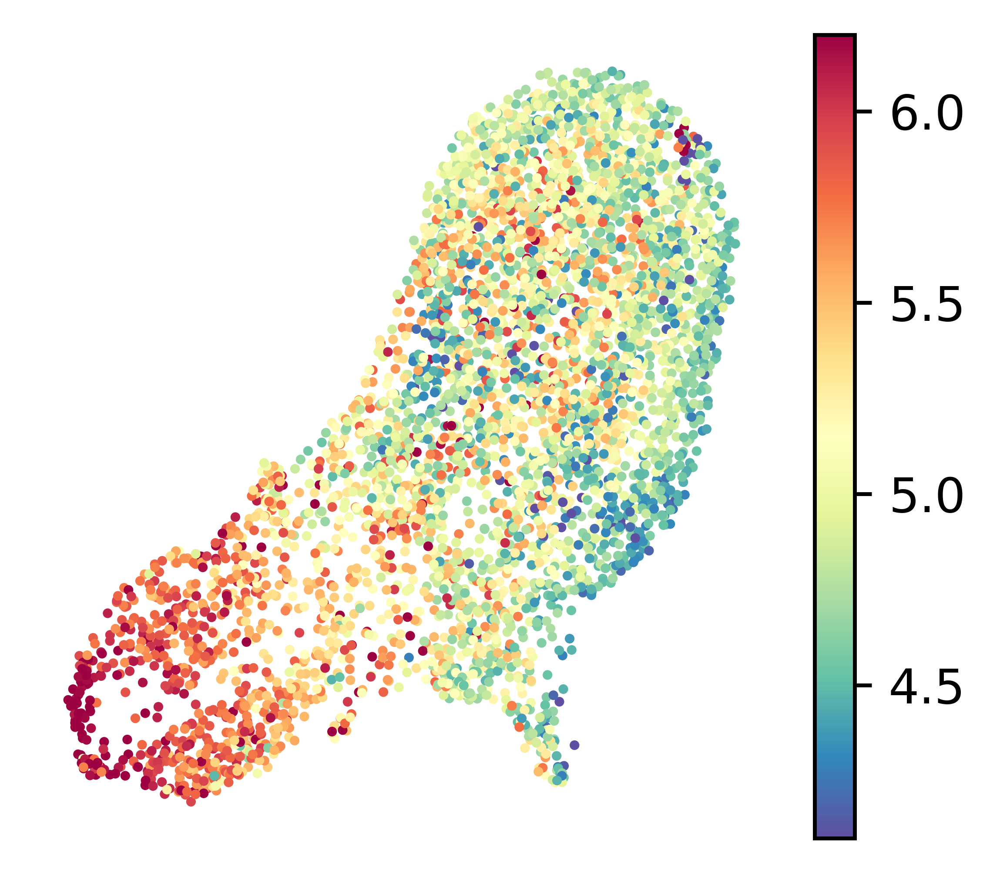

In [14]:
fig, ax = plt.subplots(1,1,figsize=(3.4,3),dpi=800)
g = plt.scatter(codex_adata_copy.obsm['X_umap'][:,0],
                codex_adata_copy.obsm['X_umap'][:,1],
                s=1,
                c = codex_adata_copy[:,'Mouse-CD31-Pecam'].to_df().values,
                cmap = 'Spectral_r',
                vmin=4.1,
                vmax=6.2
               )
plt.colorbar(g)
plt.axis('off') 
#plt.yticks([])

In [8]:
keep_gene_names = {
    'CD8a': 'Cd8a',
    'CD4': 'Cd4',
    'CD68': 'Cd68',
    'CD29': 'Itgb1',
    'CD3': 'Cd3e',
    'CD19': 'Cd19',
    'CD31': 'Pecam1',
    'IgG2b': 'Ighg2b',
    'CD38': 'Cd38',
    'CD45R': 'Ptprc',
    #'IgG2a': 'Ighg2a',
    'F480': 'Adgre1',
    'CD169': 'Siglec1',
    'IgD': 'Ighd',
    'CD140a': 'Pdgfra',
    'CX3CR1': 'Cx3cr1',
    'CD163': 'Cd163',
    'CD304': 'Nrp1',
    'Ly6C': 'Ly6c1',
    'CD226': 'Cd226',
    'P2RY12': 'P2ry12',
    'P2X7R': 'P2rx7',
    'CD14': 'Cd14',
    'CXCR4': 'Cxcr4',
    'CD79b': 'Cd79b',
    'CD335': 'Ncr1',
    'CD11b': 'Itgam',
    'CD44': 'Cd44',
    'IgG1': 'Ighg1',
    'IgG2b': 'Ighg2b',
    'CD88': 'C5ar1',
    'CD5': 'Cd5',
    'BST': 'Bst2',
    'CD90': 'Thy1',
    'Ly6G': 'Ly6g',
    'CD11c': 'Itgax',
    'IgM': 'Ighm',
    'CD40': 'Cd40',
    'CD71': 'Tfrc'
}

In [11]:
visium_adata_copy.to_df()

,Gm1992,Gm37381,Rp1,Xkr4,Sox17,Mrpl15,Rgs20,Tcea1,Gm37988,Oprk1,...,Csprs,AC125149.3,AC125149.4,AC168977.1,Vamp7,Tmlhe,AC149090.1,CAAA01118383.1,CAAA01147332.1,Tmsb4x
0_22,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
0_33,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,7.0
0_40,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0
0_41,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0
0_42,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9_73,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0
9_74,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
9_75,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0
9_8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2.0


In [12]:
visium_adata_copy = visium_adata.copy()

sc.pp.normalize_total(visium_adata_copy,target_sum=1e4)
sc.pp.log1p(visium_adata_copy)
sc.pp.highly_variable_genes(visium_adata_copy, n_top_genes=3000)

visium_adata_copy.var.loc[[keep_gene_names[i] for i in keep_gene_names.keys()], 'highly_variable'] = True

visium_adata = visium_adata[:, visium_adata_copy.var['highly_variable']].copy()

In [13]:
np.save('fig4_gene_list.npy',visium_adata.var_names.values,)

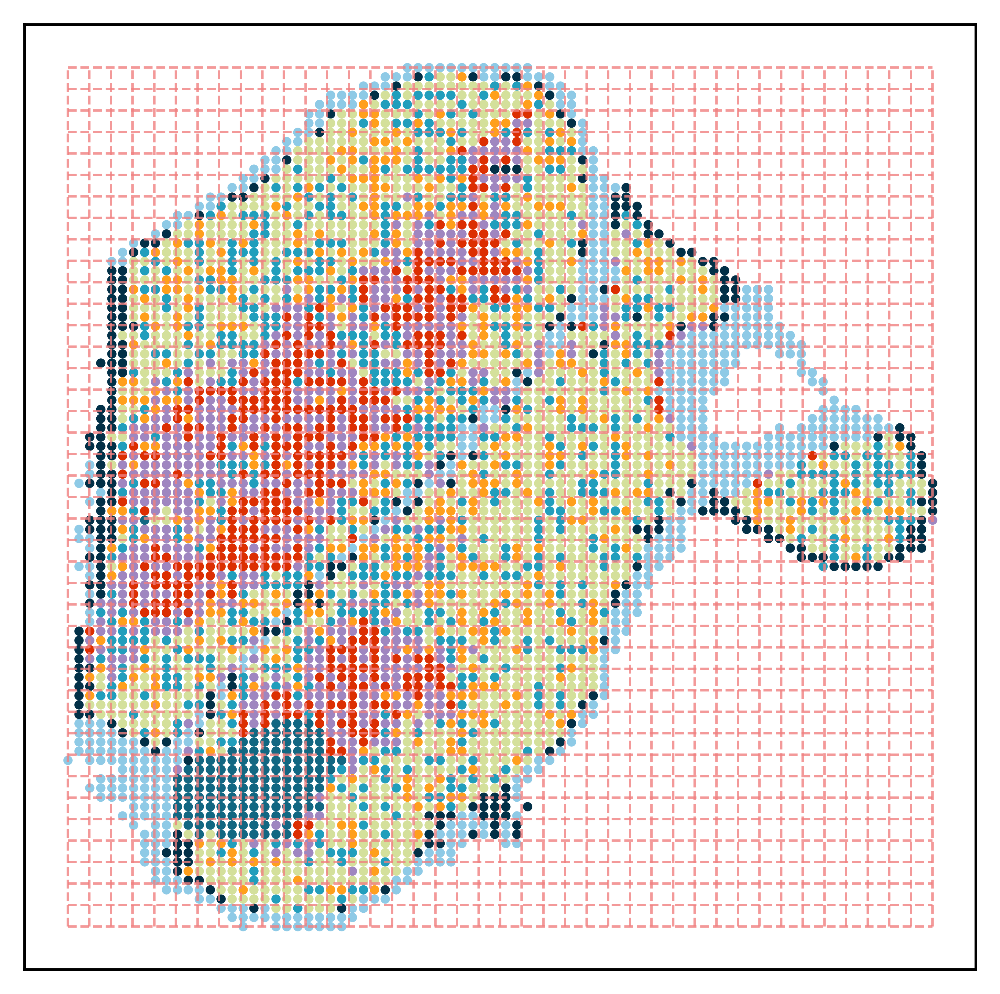

In [14]:
color_list = [
'#8ecae6',
'#219ebc',
'#126782',
'#023047',
'#9f86c0',                                   
'#d4e09b',
    
'#ff9f1c',
'#dc2f02',

'#dc2f02',
'#9d0208',
'#f08080',
'#f94144',
                    '#f3722c',
                    '#f8961e',
                    '#f9c74f',
                    '#90be6d',
                    '#43aa8b',
                    '#577590',  
                    '#226CE0',
                    '#534B62'
]
visium_adata.obs['type'] = codex_adata_copy.obs['cluster'].copy()
block_data, block_spatial = utils_simu.downsample_and_plot_spatial_data_smooth(visium_adata,
                                                                        color_list=color_list,
                                                             n_blocks_x=40, 
                                                             n_blocks_y=40,
                                                             size = 3,
                                                             figsize=(5,5),
                                                             invert_yaxis=False
                                                                       )
block_data = block_data[:,0,:]
# Create a new AnnData object for the downsampled data
visium_adata_r1 = sc.AnnData(X=block_data)
visium_adata_r1.obsm['spatial'] = block_spatial

6
7
3
1
2
4
0
5


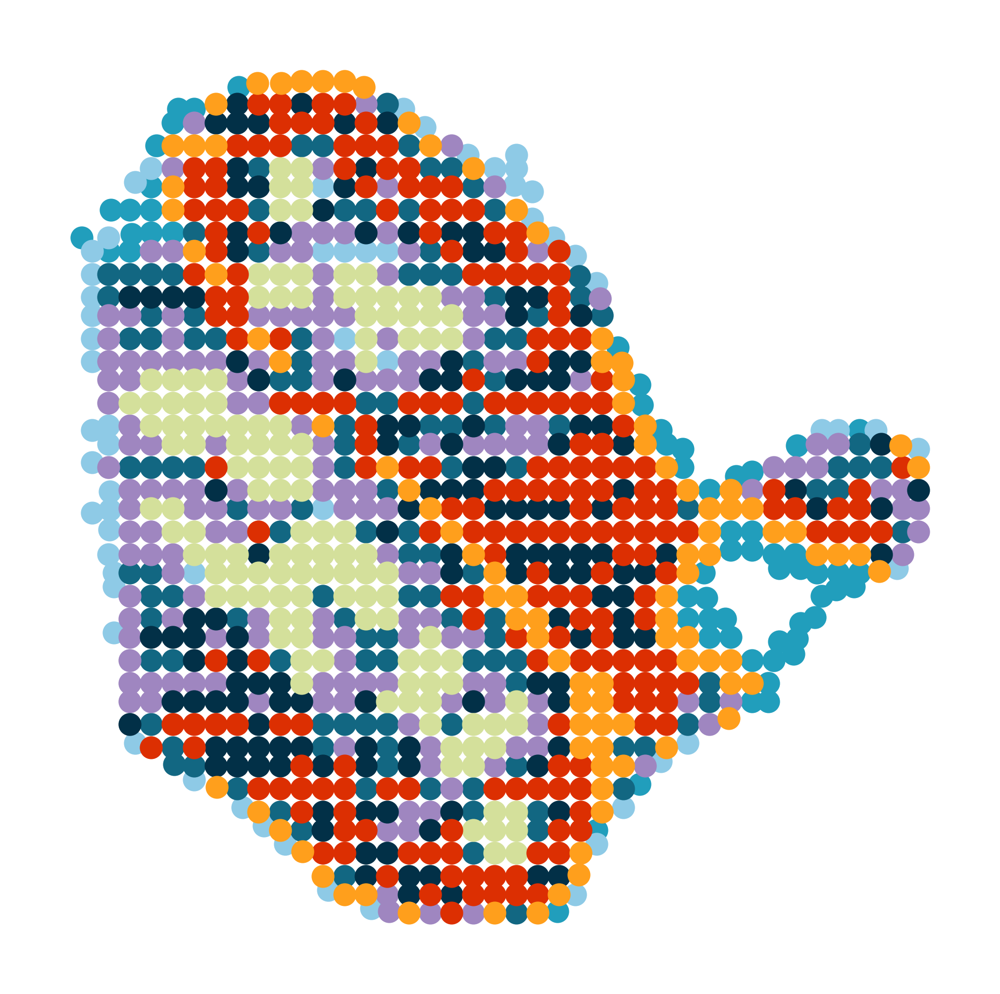

In [15]:
visium_adata_r1_cluster = utils_simu.plot_pca_cluster(visium_adata_r1,
                               res=1.2,
                               size =10,
                            color_list = [
'#219ebc',
'#8ecae6',
'#126782',
'#9f86c0', 
'#023047',                                  
'#d4e09b', 
'#dc2f02',
'#ff9f1c',


'#dc2f02',
'#9d0208',
'#f08080',
'#f94144',
'#f3722c',
'#f8961e',
'#f9c74f',
'#90be6d',
'#43aa8b',
'#577590',  
'#226CE0',
'#534B62'
],
                                #legd = True,
                                return_ = True,
                                 figsize = (3,3),
                                axis_ = False,
                             #invert_yaxis=False
                              )

In [16]:
codex_adata.obs['cell_type'] = codex_adata_copy.obs['cluster']

/tmp/ipykernel_3135318/792218029.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  codex_adata.obs['cell_type'] = codex_adata_copy.obs['cluster']


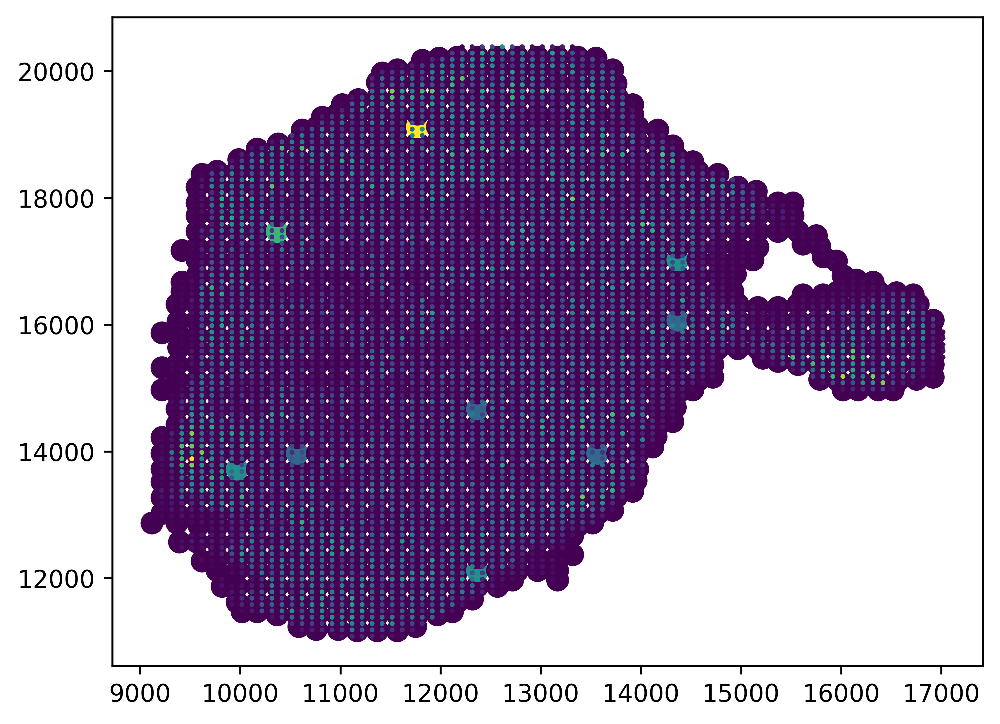

In [42]:
plt.figure(dpi=600)
plt.scatter(visium_adata_r1.obsm['spatial'][:,0],
            visium_adata_r1.obsm['spatial'][:,1],
            s=70,
            c= visium_adata_r1.to_df().iloc[:,2]
           )

plt.scatter(codex_adata.obsm['spatial'][:,0],
            codex_adata.obsm['spatial'][:,1],
            s=1,
            c= codex_adata.to_df().iloc[:,2]
           )

In [17]:
codex_adata.X = codex_adata.X.toarray()

In [18]:
#
combined_expr, codex_coords, one_hot_cell_types, spot_indices, visium_expr = utils.preprocess_data(visium_adata_r1, codex_adata)
    
dataloader = utils.prepare_local_subgraphs(combined_expr, codex_coords, one_hot_cell_types, 
                                           spot_indices, visium_expr,n_neighbors=40)    


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/torch_geometric/deprecation.py:22: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


In [19]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

if torch.cuda.is_available():
    print("GPU is available.")
    gpu_count = torch.cuda.device_count()
    print(f"Number of GPUs available: {gpu_count}")
    for i in range(gpu_count):
        print(f"GPU {i}: {torch.cuda.get_device_name(i)}")
else:
    print("GPU is not available.")
    

GPU is available.
Number of GPUs available: 1
GPU 0: NVIDIA H100 80GB HBM3


In [21]:
visium_adata_copy

AnnData object with n_obs × n_vars = 4468 × 23622
    obs: 'orig.ident', 'x', 'y'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'
    obsm: 'spatial'

In [22]:
codex_adata_copy.write('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/fig4/codex_adata.h5ad')
visium_adata_r1_cluster.write('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/fig4/visium_adata_r1.h5ad')
visium_adata_copy.write('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/fig4/visium_adata.h5ad')

In [23]:
model, optimizer = coral_main.create_model(visium_dim = visium_adata_r1.shape[1],
                                           codex_dim = codex_adata.shape[1],
                                           cell_type_dim=one_hot_cell_types.shape[1],
                                          
                                           latent_dim=32, 
                                           hidden_channels=128, 
                                           v_dim = 1
                                          )
model.to(device)


CORAL_model(
  (encoder_visium): Sequential(
    (0): Linear(in_features=3036, out_features=128, bias=True)
    (1): ReLU()
    (2): Linear(in_features=128, out_features=64, bias=True)
  )
  (encoder_codex): Sequential(
    (0): Linear(in_features=51, out_features=128, bias=True)
    (1): ReLU()
    (2): Linear(in_features=128, out_features=64, bias=True)
  )
  (encoder): Sequential(
    (0): Linear(in_features=3087, out_features=128, bias=True)
    (1): ReLU()
    (2): Linear(in_features=128, out_features=64, bias=True)
  )
  (zi_prior): Sequential(
    (0): Linear(in_features=9, out_features=128, bias=True)
    (1): ReLU()
    (2): Linear(in_features=128, out_features=64, bias=True)
  )
  (cross_attention): CrossAttentionLayer(
    (query_proj): Linear(in_features=32, out_features=32, bias=True)
    (key_proj): Linear(in_features=32, out_features=32, bias=True)
    (value_proj): Linear(in_features=32, out_features=32, bias=True)
    (softmax): Softmax(dim=-1)
  )
  (deconv): Deconvol

In [24]:
coral_main.train_model(model, optimizer, dataloader, epochs = 100 ,device = device)


Epoch 0, Loss: 795340.762186941
Epoch 1, Loss: 761429.5305232558
Epoch 2, Loss: 747990.1909660107
Epoch 3, Loss: 738812.0080500895
Epoch 4, Loss: 732800.3441413238
Epoch 5, Loss: 728854.1031976744
Epoch 6, Loss: 724813.7683363148
Epoch 7, Loss: 721402.4372763864
Epoch 8, Loss: 718934.4373881932
Epoch 9, Loss: 717124.6400939177
Epoch 10, Loss: 714620.1209749553
Epoch 11, Loss: 713159.5741279069
Epoch 12, Loss: 711856.3057356888
Epoch 13, Loss: 710761.2251788909
Epoch 14, Loss: 709415.3129472272
Epoch 15, Loss: 708164.1546288014
Epoch 16, Loss: 706962.8837209302
Epoch 17, Loss: 706095.7281976744
Epoch 18, Loss: 705245.7009168158
Epoch 19, Loss: 704786.1217016994
Epoch 20, Loss: 704213.155131932
Epoch 21, Loss: 703653.3067978533
Epoch 22, Loss: 702727.0180008945
Epoch 23, Loss: 702320.0370080501
Epoch 24, Loss: 701761.4568984794
Epoch 25, Loss: 701711.694655635
Epoch 26, Loss: 700611.2504472272
Epoch 27, Loss: 700337.3329047406
Epoch 28, Loss: 700146.6898479428
Epoch 29, Loss: 699418.7562

In [49]:
import torch

# Define the path where you want to save the model
model_save_path = "model_thymus.pth"
optimizer_save_path = "optimizer_thymus.pth"


In [50]:

# Save the model's state_dict
torch.save(model.state_dict(), model_save_path)
# Save the optimizer's state_dict
torch.save(optimizer.state_dict(), optimizer_save_path)


In [57]:
#model_save_path = "model.pth"
#optimizer_save_path = "optimizer.pth"

model.load_state_dict(torch.load(model_save_path))

# If you saved the optimizer as well, load it
optimizer.load_state_dict(torch.load(optimizer_save_path))

In [161]:
(generated_expr, 
 generated_protein,latent_rep, 
 locations,
 visium_true,
 codex_true, 
 attn_weights_all, 
 edges_all,
 v_values, 
 cell_types)= coral_main.generate_and_validate(model, dataloader,device) 

In [162]:
adata_model_gener = anndata.AnnData(generated_protein)
adata_model_gener.obsm['generated_expr'] = generated_expr
adata_model_gener.obsm['coral'] = latent_rep
adata_model_gener.obsm['spatial'] = locations
adata_model_gener.obsm['visium_true'] = visium_true
adata_model_gener.obsm['codex_true'] = codex_true
#adata_model_gener.obsm['attn_weights_all'] = attn_weights_all
adata_model_gener.obsm['v_values'] = v_values
adata_model_gener.obsm['cell_types'] = cell_types

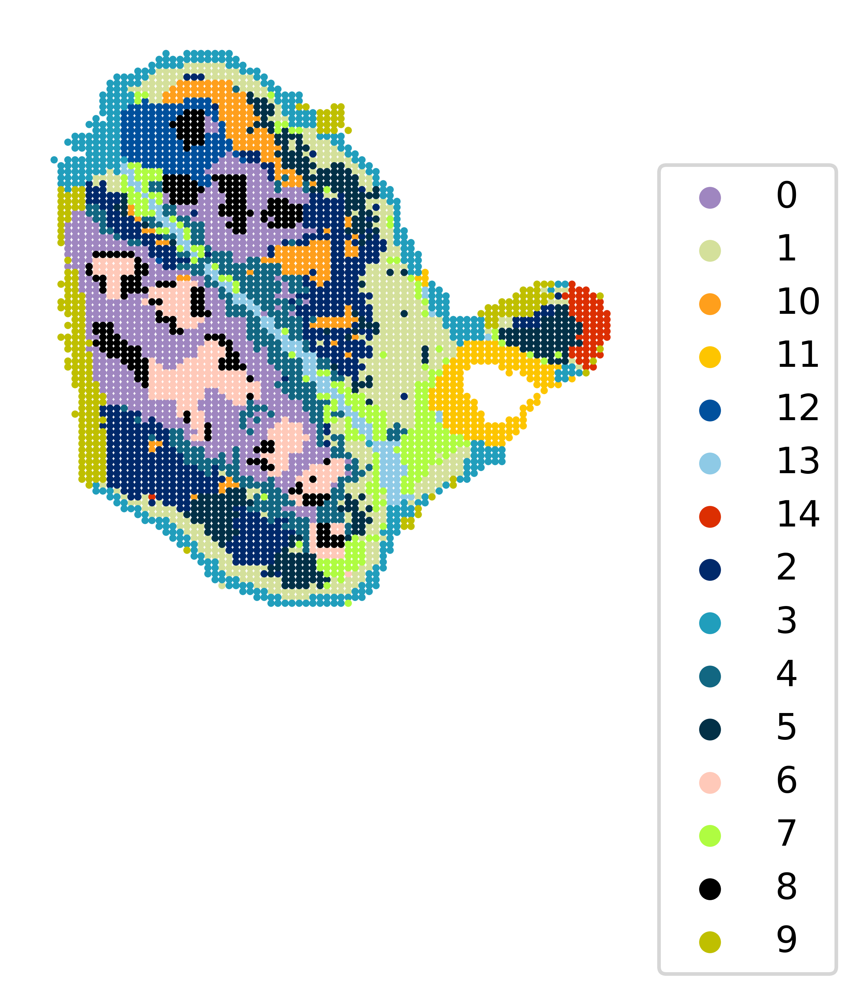

In [171]:
adata_cluster = utils_simu.plot_latent_cluster(adata_model_gener,
                               res  = 0.91,
                               size =1,
color_list = [
    '#9f86c0',                                   
'#d4e09b',
'#ff9f1c',
    '#fdc500',
'#00509d', 
'#8ecae6',
'#dc2f02',
'#00296b',                                                   


'#219ebc',
'#126782',
'#023047',
 
'#ffc9b9',   
'#affc41', 
'k',
    'y',
    'g',
],
                               figsize=(3,3),                
                               use_rep = 'coral',
                               legd = True,
                               return_ = True,
                              )

0
1
10
11
12
13
14
2
3
4
5
6
7
8
9


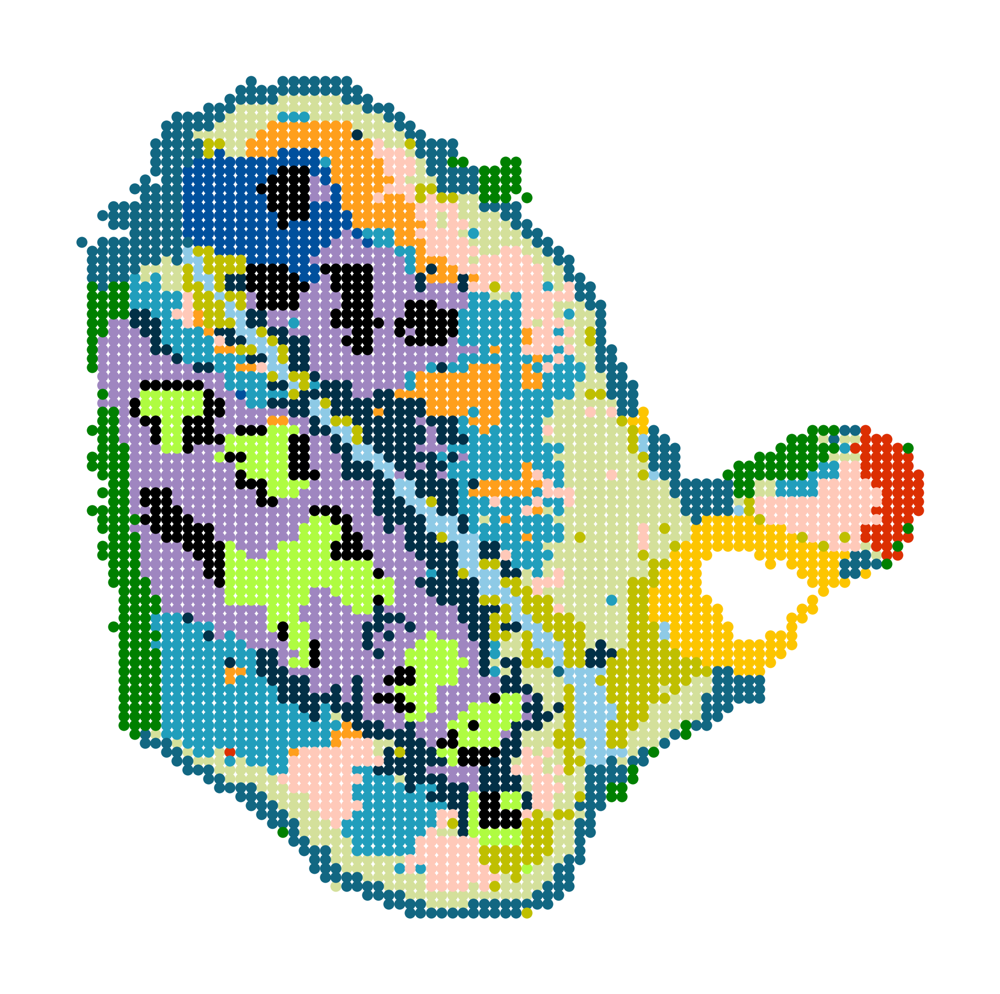

In [188]:
color_list = {
  
'0':'#9f86c0',
'1':'#d4e09b',                                   
'2':'#219ebc', 
'3':'#126782',
'4':'#023047',
'5':'#ffc9b9',
'6':'#affc41',

'7':'y',
'8':'k',  
'9':'g',
'10':'#ff9f1c', 
    
'11':'#fdc500',
'12':'#00509d',
'13':'#8ecae6',                                             

'14':'#dc2f02',   
'15':'#00296b',
}
fig, ax = plt.subplots(1,1,figsize=(3,3),dpi=800)
for j,i in enumerate(sorted(adata_cluster.obs['cluster'].unique())):
    print(i)
    plt.scatter(adata_cluster.obsm['spatial'][adata_cluster.obs['cluster']==i,0],
                adata_cluster.obsm['spatial'][adata_cluster.obs['cluster']==i,1],
                s=1,
                color = color_list[i]
               )
plt.legend(sorted(adata_cluster.obs['cluster'].unique()),bbox_to_anchor=(1.01,0.8))
plt.axis('off') 
plt.legend([], [], frameon=False)
plt.gca().invert_yaxis()

0
1
10
11
12
13
14
2
3
4
5
6
7
8
9


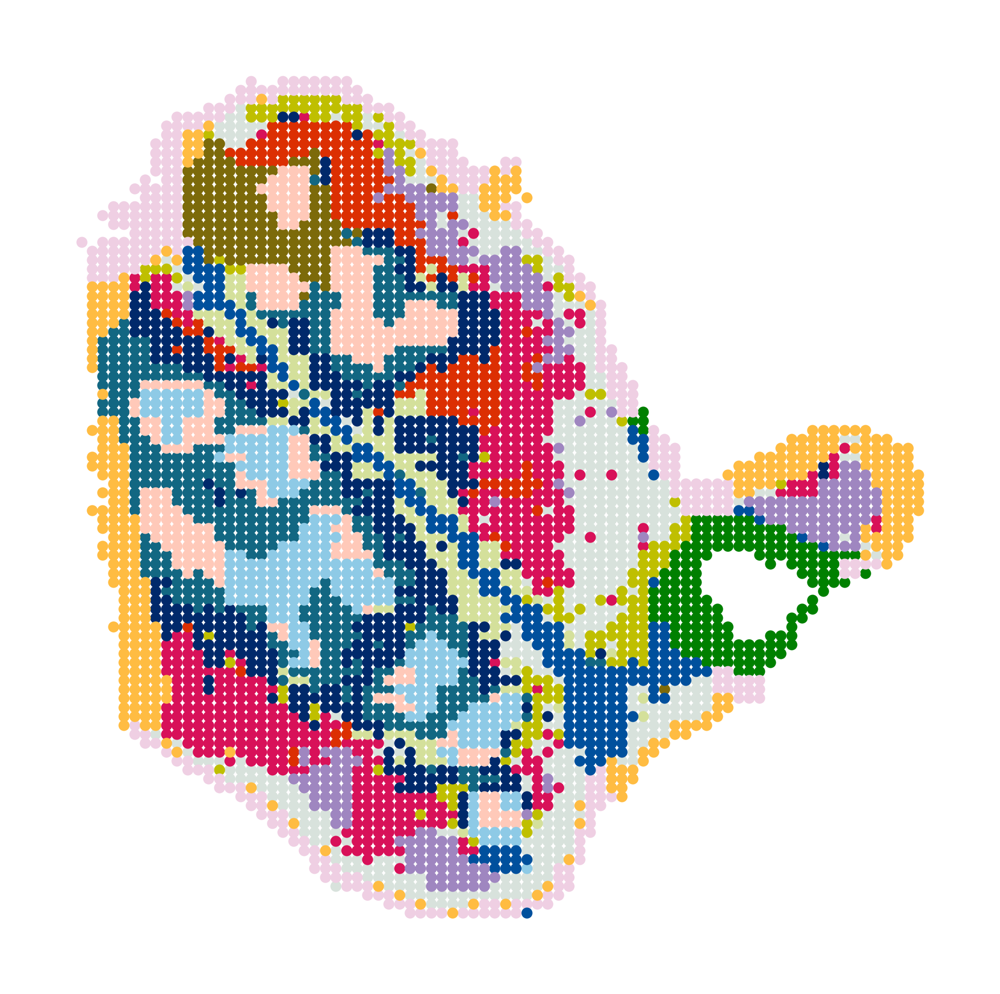

In [46]:
color_list = [
'#d8e2dc', #0
'#d81159', #1  219ebc
'#dc2f02', #10
'#d4e09b', #11
'y', #12                                   
'g',#13 
'#7c6a0a',#14
'#126782',#15
'#00296b', #16                                                   

'#efcfe3',#17
'#ffbc42', #2  
'#ffc9b9',  #3  
'#8ecae6', #4 
'#00509d',#5
'#9f86c0',#6 
'#023047',#7
'#c08497',#8
'#432534', #9
'#ffc9b9',  #10  
'#affc41', #11 
'k',#12 
'y',#13 
'g'#14 
]
fig, ax = plt.subplots(1,1,figsize=(3,3),dpi=800)
for j,i in enumerate(sorted(adata_cluster.obs['cluster'].unique())):
    print(i)
    plt.scatter(adata_cluster.obsm['spatial'][adata_cluster.obs['cluster']==i,0],
                adata_cluster.obsm['spatial'][adata_cluster.obs['cluster']==i,1],
                s=1,
                color = color_list[j]
               )
#plt.legend(sorted(adata_cluster.obs['cluster'].unique()),bbox_to_anchor=(1.01,0.8))
plt.axis('off') 
plt.gca().invert_yaxis()

In [173]:
def reindex_adata_qz(adata: anndata.AnnData, adata_qz: anndata.AnnData) -> anndata.AnnData:
    """
    Reindex adata_qz to match the order of adata based on spatial coordinates.

    Parameters:
    - adata: AnnData object containing the reference spatial coordinates.
    - adata_qz: AnnData object to be reindexed based on spatial coordinates.

    Returns:
    - adata_qz_reindexed: Reindexed AnnData object.
    """

    # Extract spatial coordinates
    spatial_coords_adata = adata.obsm['spatial']
    spatial_coords_adata_qz = adata_qz.obsm['spatial']

    # Find nearest neighbors
    tree = cKDTree(spatial_coords_adata_qz)
    distances, indices = tree.query(spatial_coords_adata)

    # Reindex adata_qz
    adata_qz_reindexed = adata_qz[indices].copy()
    adata_qz_reindexed.obs.index = adata.obs.index

    return adata_qz_reindexed
adata_model_gener_reindexed = reindex_adata_qz(codex_adata, adata_model_gener)
#

In [175]:
adata_model_gener_reindexed.obs

,leiden,cluster
0_22,11,11
0_33,2,2
0_40,12,12
0_41,13,13
0_42,5,5
...,...,...
9_73,2,2
9_74,8,8
9_75,10,10
9_8,14,14


In [45]:
adata_model_gener_reindexed

adata_model_gener_reindexed.write('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/fig4/coral_fig4_3.h5ad')


In [136]:
adata_model_gener_reindexed = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/fig4/coral_fig4.h5ad')

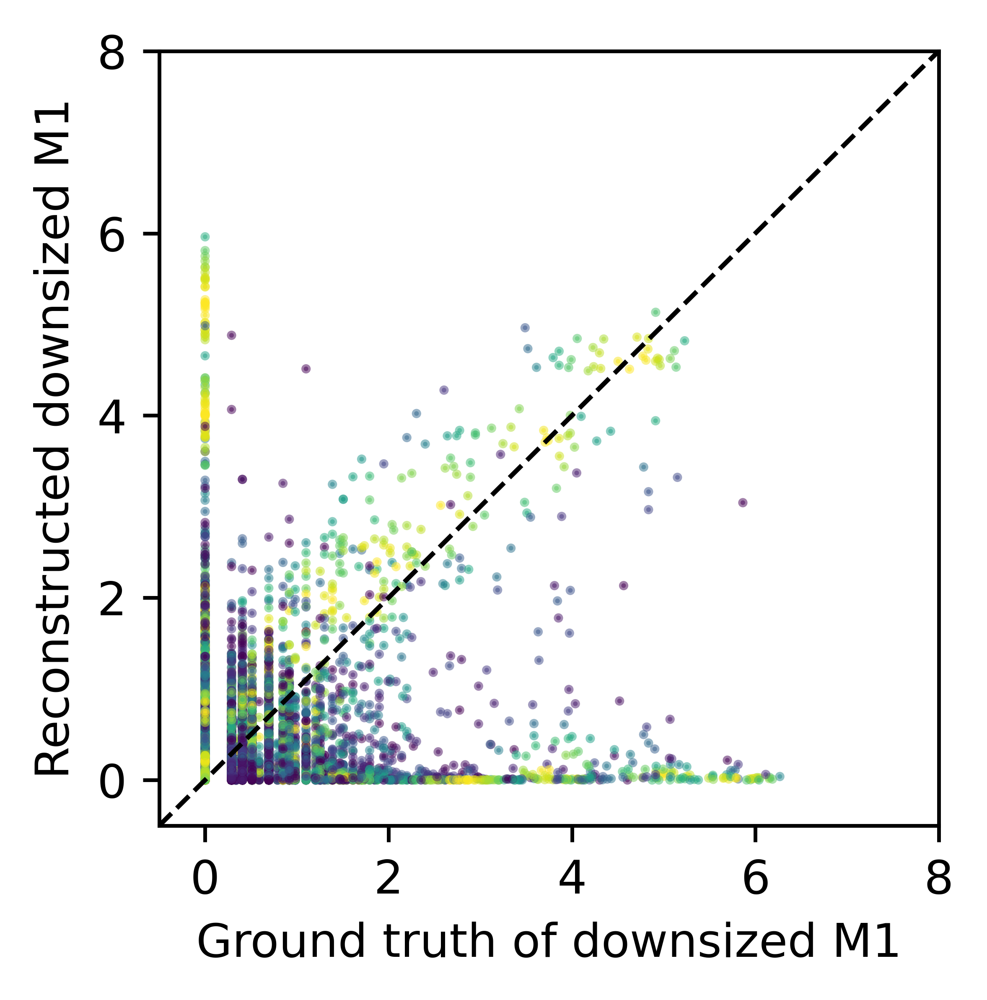

In [56]:
generated_adata = anndata.AnnData(adata_model_gener_reindexed.obsm['generated_expr'])
#generated_adata.obsm['latent_rep'] = latent_rep
#generated_adata.obsm['spatial'] = locations

utils.display_reconst(
                pd.DataFrame(np.log1p(np.array(visium_true))),
                pd.DataFrame(np.log1p(np.array(generated_adata.X))),
                density=True,
                x_label='Ground truth of downsized M1',
                y_label='Reconstructed downsized M1',
                size=(3,3),
                min_val=-0.5,
                max_val=8,
               )

In [57]:
from scipy import stats
stats.pearsonr(
            (np.array(visium_true)).flatten(),
            (np.array(generated_expr)).flatten(),
           )


PearsonRResult(statistic=0.11799503424323707, pvalue=0.0)

In [44]:
from sklearn.metrics.pairwise import cosine_similarity

cosine_sim = cosine_similarity(
    (np.array(visium_true)).flatten().reshape(1, -1),
    (np.array(generated_expr)).flatten().reshape(1, -1)
)[0][0]
print(f"Cosine Similarity: {cosine_sim}")

Cosine Similarity: 0.9333575963973999


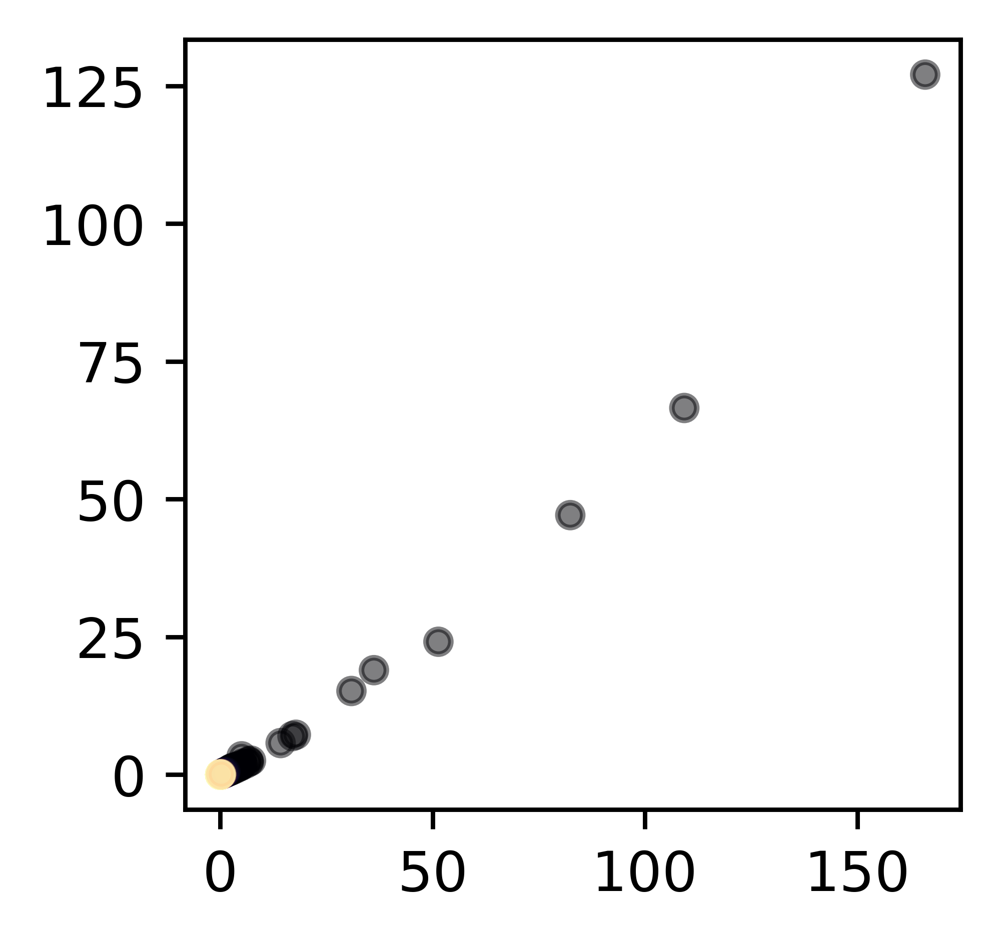

In [46]:
from scipy.stats import gaussian_kde
df_true_sample = pd.DataFrame(generated_expr.mean(axis=0))
df_pred_sample = pd.DataFrame(visium_adata.X.toarray().mean(axis=0))

plt.figure(figsize=(2.5,2.5),dpi=800)
ax = plt.gca()

xx = df_true_sample.T.to_numpy().flatten()
yy = df_pred_sample.T.to_numpy().flatten()


for gene in df_true_sample.columns:
    try:
        gene_true = df_true_sample[gene].values
        gene_pred = df_pred_sample[gene].values
        gexp_stacked = np.vstack([df_true_sample[gene].values, df_pred_sample[gene].values])

        z = gaussian_kde(gexp_stacked)(gexp_stacked)
        ax.scatter(gene_true, gene_pred, c=z, s=20, alpha=0.5,cmap='magma')
    except np.linalg.LinAlgError as e:
        pass

In [48]:
from scipy import stats
stats.pearsonr(
            (generated_expr.mean(axis=0)).flatten(),
            (visium_adata.X.toarray().mean(axis=0)).flatten(),
           )



PearsonRResult(statistic=0.986770649121801, pvalue=0.0)

In [49]:
cosine_sim = cosine_similarity(
    np.array(generated_expr.mean(axis=0)).flatten().reshape(1, -1),
    np.array(visium_adata.X.toarray().mean(axis=0)).flatten().reshape(1, -1)
)[0][0]
print(f"Cosine Similarity: {cosine_sim}")

Cosine Similarity: 0.9866511514663542


In [167]:
adata_model_gener_reindexed.obs

,leiden,cluster
0_22,12,12
0_33,0,0
0_40,14,14
0_41,13,13
0_42,6,6
...,...,...
9_73,0,0
9_74,3,3
9_75,6,6
9_8,15,15


In [177]:
concat_ =anndata.AnnData(np.concatenate([adata_model_gener_reindexed.obsm['generated_expr']],axis=1))
sc.pp.normalize_total(concat_)
sc.pp.log1p(concat_)
sc.pp.pca(concat_)
sc.pp.neighbors(concat_,n_neighbors=15)
sc.tl.umap(concat_,min_dist=0.5)
sc.tl.leiden(concat_,resolution=0.55)


adata_model_gener_reindexed.obsm['sc_inte_umap'] = concat_.obsm['X_umap']
adata_model_gener_reindexed.obs['sc_leiden'] =  np.array(concat_.obs['leiden'])



In [178]:
adata_model_gener_reindexed.obs['cluster'].unique()

array(['11', '2', '12', '13', '5', '8', '6', '1', '4', '9', '3', '7', '0',
       '10', '14'], dtype=object)

In [179]:
adata_model_gener_reindexed.obs['ground_type'] = adata.obs['Annotation']


In [131]:
sc.tl.umap(codex_adata_copy,min_dist=0.1) 

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/scanpy/tools/_umap.py:179: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["umap"] = {"params": {"a": a, "b": b}}


In [180]:
adata_model_gener_reindexed = adata_model_gener_reindexed[~pd.isna(adata_model_gener_reindexed.obs['ground_type'])]

In [133]:
codex_adata_copy = codex_adata_copy[adata_model_gener_reindexed.obs_names]

Text(0, 0.5, '')

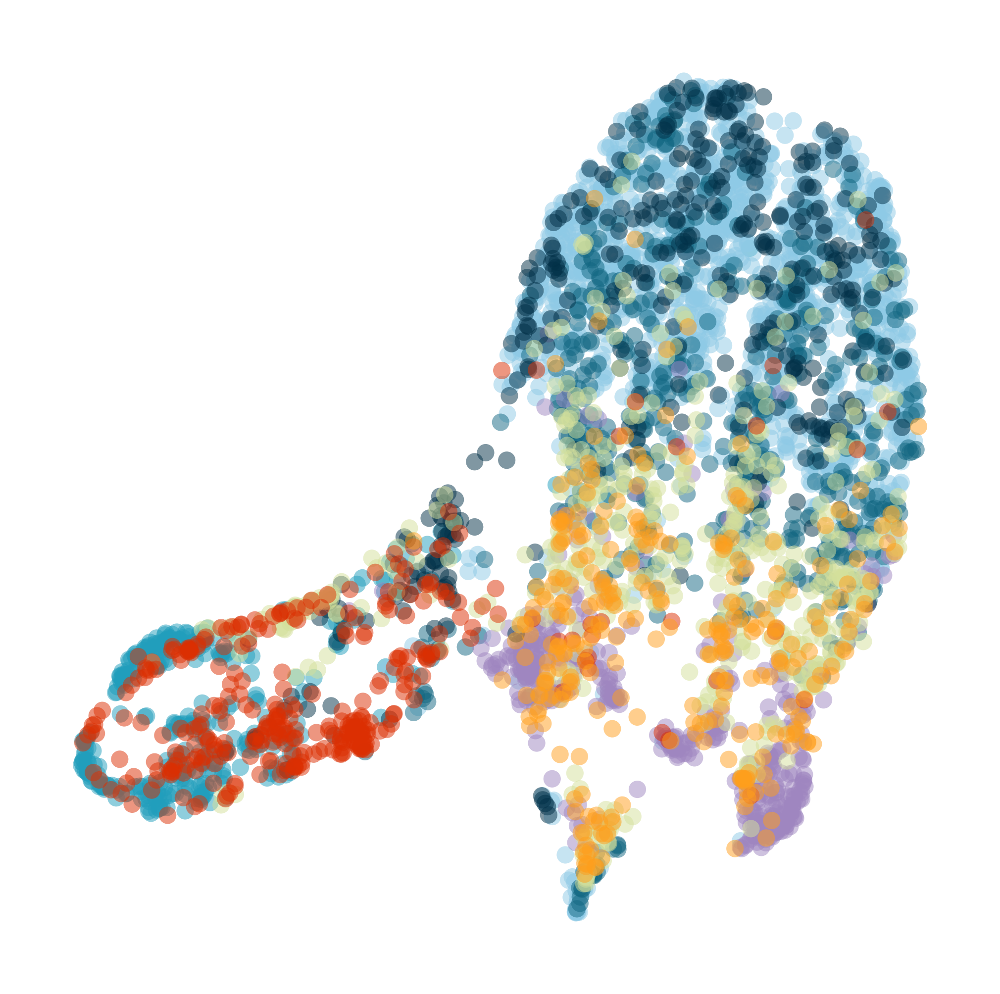

In [134]:

color_list = [
'#219ebc',
'#8ecae6',
'#126782',
'#9f86c0', 
'#023047',                                  
'#d4e09b', 
'#dc2f02',
'#ff9f1c',


'#dc2f02',
'#9d0208',
'#f08080',
'#f94144',
'#f3722c',
'#f8961e',
'#f9c74f',
'#90be6d',
'#43aa8b',
'#577590',  
'#226CE0',
'#534B62'
]

fig, ax = plt.subplots(1,1,figsize=(3,3),dpi=800)
for j,i in enumerate(adata.obs['Annotation'].unique()):
    plt.scatter(codex_adata_copy.obsm['X_umap'][adata_model_gener_reindexed.obs['ground_type']==i,0],
                codex_adata_copy.obsm['X_umap'][adata_model_gener_reindexed.obs['ground_type']==i,1],
                s=10,
                edgecolor='none',
                color = color_list[j],
                alpha = 0.5,
               )
#plt.legend(adata.obs['Annotation'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.xlabel('')
plt.ylabel('')

Connective tissue capsule (fibroblast, RBC, myeloid)
Outer cortex region 3 (DN T, DP T,cTEC)
Middle cortex region 2 (DN T, DP T,cTEC)
Medulla (SP T, mTEC, DC)
Subcapsular zone (DN T)
Inner cortex region 1 (DN T, DP T, cTEC)
Connective tissue capsule (fibroblast)
Corticomedullary junction (CMJ)


Text(0, 0.5, '')

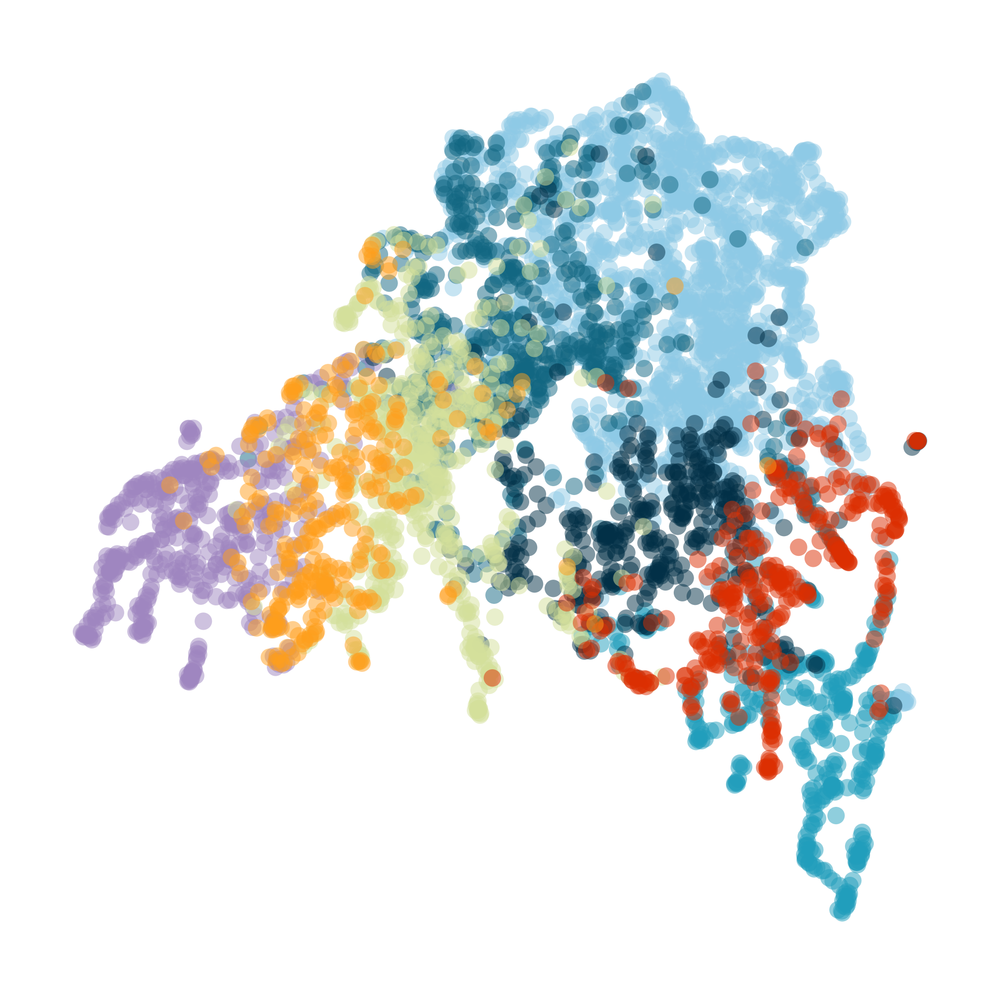

In [135]:

plt.subplots(1,1,figsize= (3,3),dpi=800)
for j,i in enumerate(adata_model_gener_reindexed.obs['ground_type'].unique()):
    print(i)
    plt.scatter(adata_model_gener_reindexed.obsm['sc_inte_umap'][adata_model_gener_reindexed.obs['ground_type']==i,0],
                adata_model_gener_reindexed.obsm['sc_inte_umap'][adata_model_gener_reindexed.obs['ground_type']==i,1],
                s=10,
                alpha = 0.5,
                edgecolor='none',
                color = color_list[j]
               )
#plt.legend(adata_model_gener_reindexed.obs['ground_type'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.xlabel('')
plt.ylabel('')

In [136]:
visium_adata.to_df().columns[[i.startswith('Cd') for i in visium_adata.to_df().columns]]

Index(['Cdk15', 'Cdk18', 'Cd244', 'Cd34', 'Cdkl3', 'Cd68', 'Cd79b', 'Cdc42ep4',
       'Cdca4', 'Cdc20b', 'Cdadc1', 'Cdh6', 'Cdh18', 'Cdc42ep1', 'Cdip1',
       'Cd200r1', 'Cd14', 'Cd74', 'Cd226', 'Cd248', 'Cd5', 'Cd44', 'Cdan1',
       'Cd40', 'Cd52', 'Cdk14', 'Cd38', 'Cd8a', 'Cd163', 'Cd4', 'Cdr2', 'Cd19',
       'Cd209b', 'Cdh3', 'Cdh1', 'Cdh13', 'Cdt1', 'Cdc37', 'Cd3d', 'Cd3e',
       'Cd276', 'Cdhr4', 'Cdcp1', 'Cd99l2'],
      dtype='object')

In [137]:
generated_expr_adata = anndata.AnnData(adata_model_gener_reindexed.obsm['generated_expr'])
generated_expr_adata.var_names = visium_adata.var_names
generated_expr_adata.obs_names = adata_model_gener_reindexed.obs_names


KeyError: 'Psmb11'

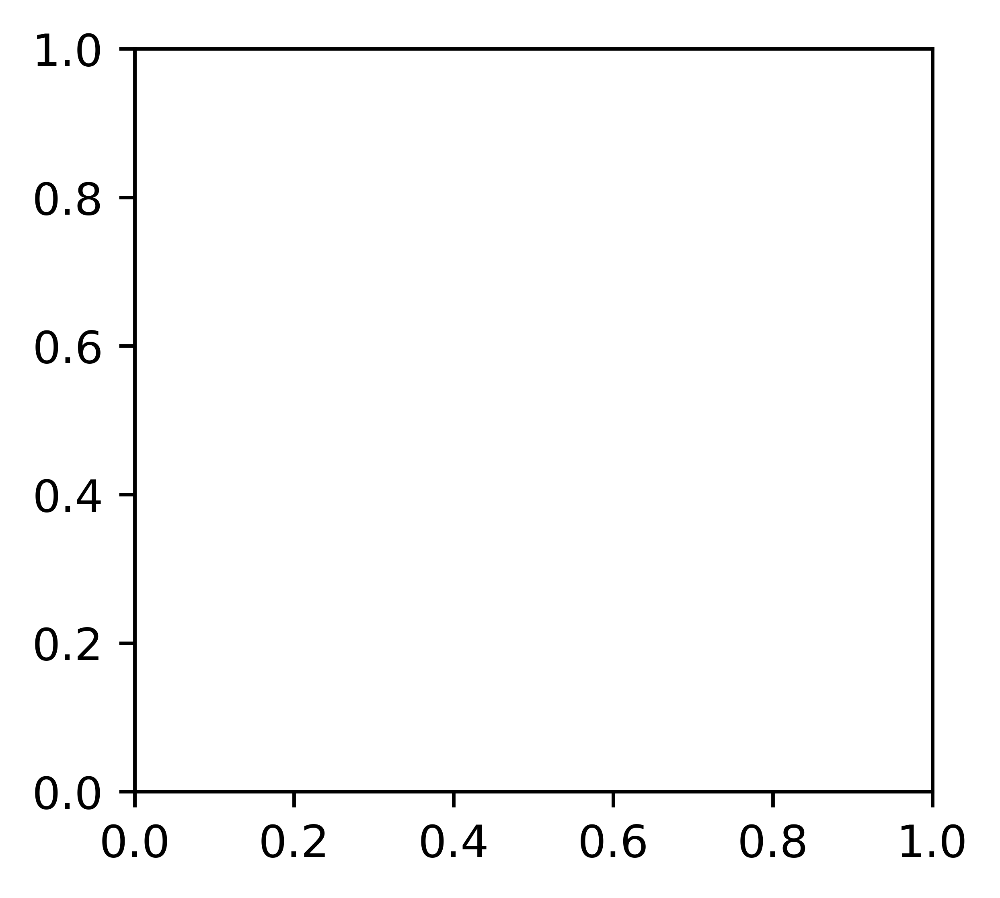

In [138]:
plt.subplots(1,1,figsize= (3.2,3),dpi=800)
g = plt.scatter(adata_model_gener_reindexed.obsm['sc_inte_umap'][:,0],
            adata_model_gener_reindexed.obsm['sc_inte_umap'][:,1],
            s=2,
            alpha = 1,
                cmap='Spectral_r',
            c = generated_expr_adata[:,'Psmb11'].to_df().values,
                vmin=0,
                vmax=2
           )
plt.colorbar(g)
#plt.legend(adata_model_gener_reindexed.obs['sc_leiden'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])

plt.yticks([])
plt.axis('off')
plt.xlabel('')
plt.ylabel('')

Text(0, 0.5, '')

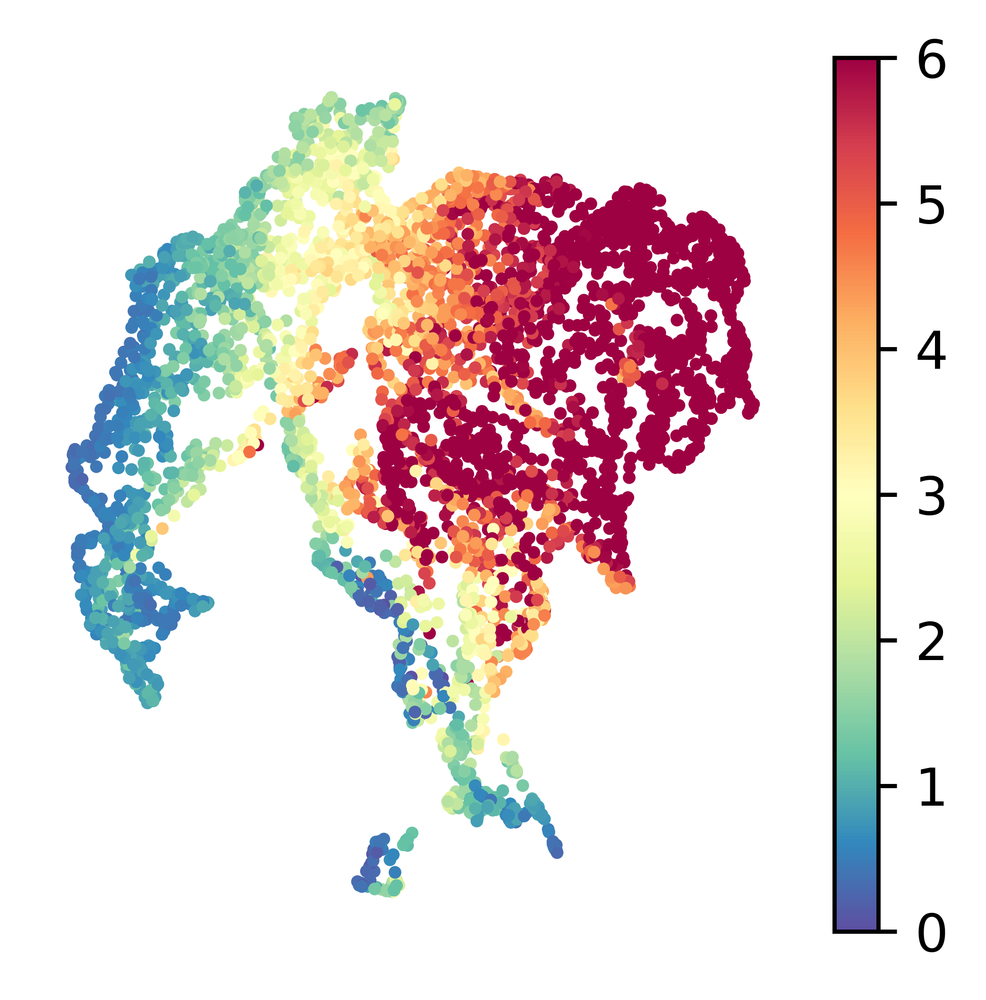

In [130]:
plt.subplots(1,1,figsize= (3.2,3),dpi=800)
g = plt.scatter(adata_model_gener_reindexed.obsm['sc_inte_umap'][:,0],
            adata_model_gener_reindexed.obsm['sc_inte_umap'][:,1],
            s=2,
            alpha = 1,
                cmap='Spectral_r',
            c = generated_expr_adata[:,'Cd8a'].to_df().values,
                vmin=0,
                vmax=6
           )
plt.colorbar(g)
#plt.legend(adata_model_gener_reindexed.obs['sc_leiden'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])

plt.yticks([])
plt.axis('off')
plt.xlabel('')
plt.ylabel('')

Text(0, 0.5, '')

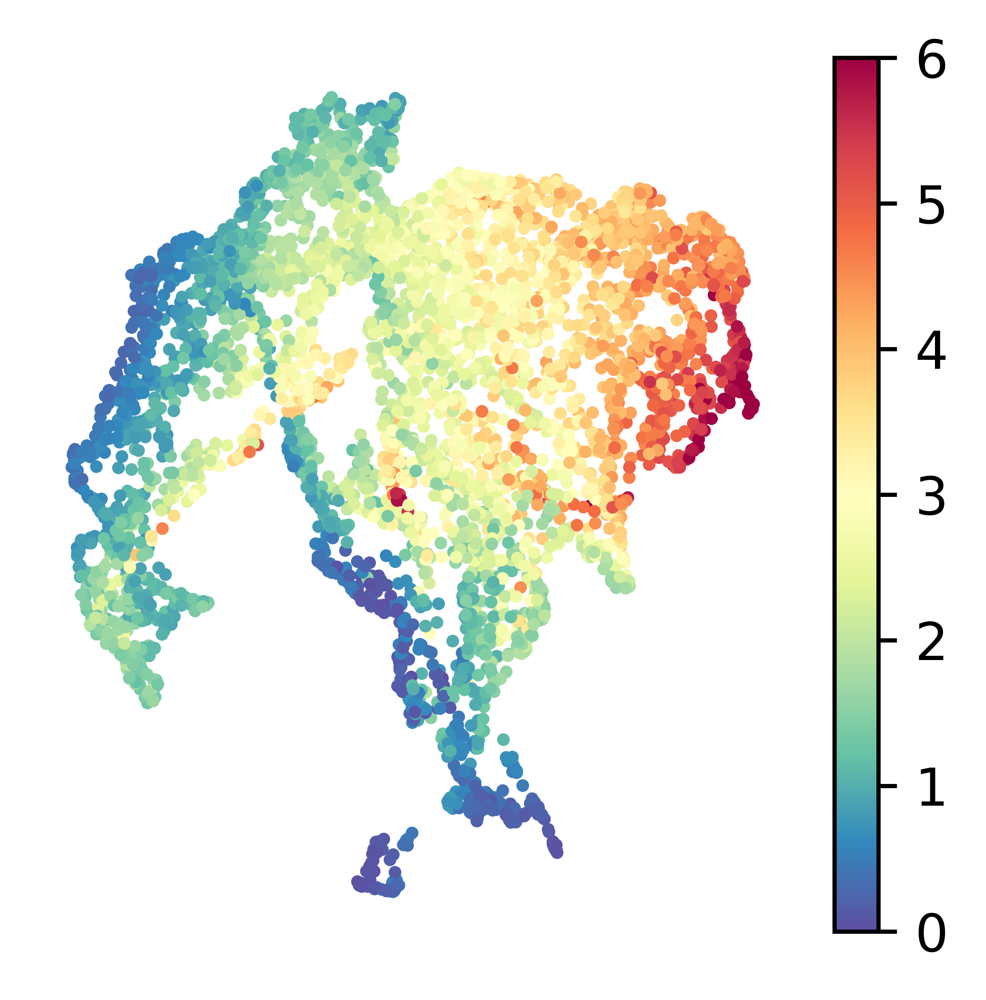

In [122]:
plt.subplots(1,1,figsize= (3.2,3),dpi=800)
g = plt.scatter(adata_model_gener_reindexed.obsm['sc_inte_umap'][:,0],
            adata_model_gener_reindexed.obsm['sc_inte_umap'][:,1],
            s=2,
            alpha = 1,
                cmap='Spectral_r',
            c = generated_expr_adata[:,'Cd3e'].to_df().values,
                vmin=0,
                vmax=6
           )
plt.colorbar(g)
#plt.legend(adata_model_gener_reindexed.obs['sc_leiden'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])

plt.yticks([])
plt.axis('off')
plt.xlabel('')
plt.ylabel('')

Text(0, 0.5, '')

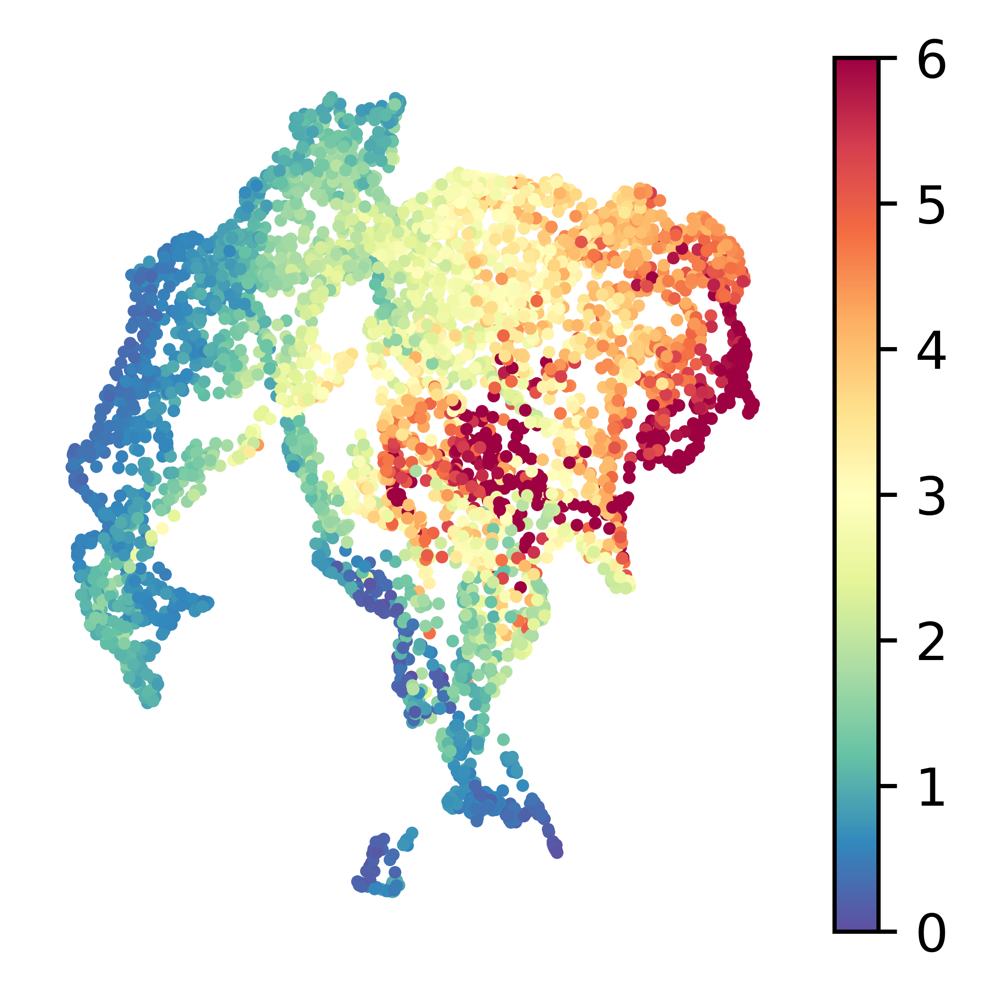

In [123]:
plt.subplots(1,1,figsize= (3.2,3),dpi=800)
g = plt.scatter(adata_model_gener_reindexed.obsm['sc_inte_umap'][:,0],
            adata_model_gener_reindexed.obsm['sc_inte_umap'][:,1],
            s=2,
            alpha = 1,
                cmap='Spectral_r',
            c = generated_expr_adata[:,'Cd4'].to_df().values,
                vmin=0,
                vmax=6
           )
plt.colorbar(g)
#plt.legend(adata_model_gener_reindexed.obs['sc_leiden'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])

plt.yticks([])
plt.axis('off')
plt.xlabel('')
plt.ylabel('')

Text(0, 0.5, '')

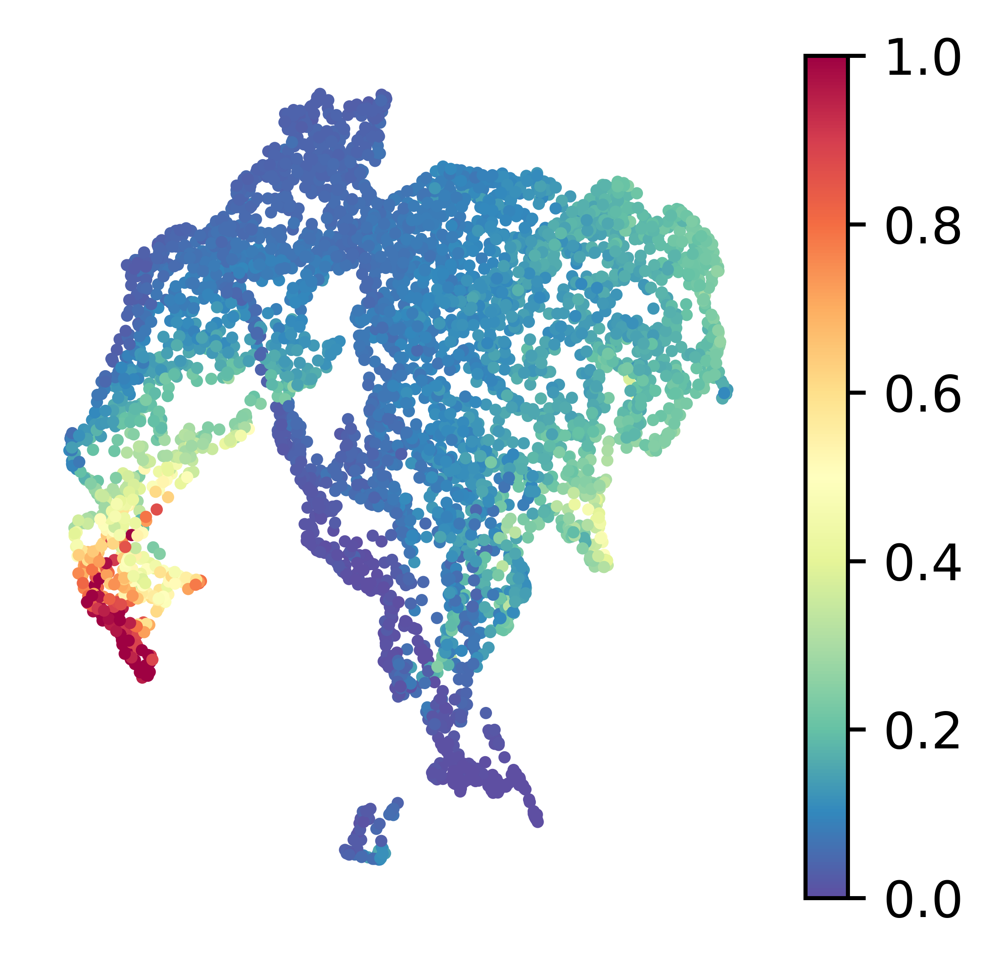

In [129]:
plt.subplots(1,1,figsize= (3.2,3),dpi=800)
g = plt.scatter(adata_model_gener_reindexed.obsm['sc_inte_umap'][:,0],
            adata_model_gener_reindexed.obsm['sc_inte_umap'][:,1],
            s=2,
            alpha = 1,
                cmap='Spectral_r',
            c = generated_expr_adata[:,'Cd40'].to_df().values,
                vmin=0,
                vmax=1
           )
plt.colorbar(g)
#plt.legend(adata_model_gener_reindexed.obs['sc_leiden'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])

plt.yticks([])
plt.axis('off')
plt.xlabel('')
plt.ylabel('')

0
1
10
11
12
13
2
3
4
5
6
7
8
9


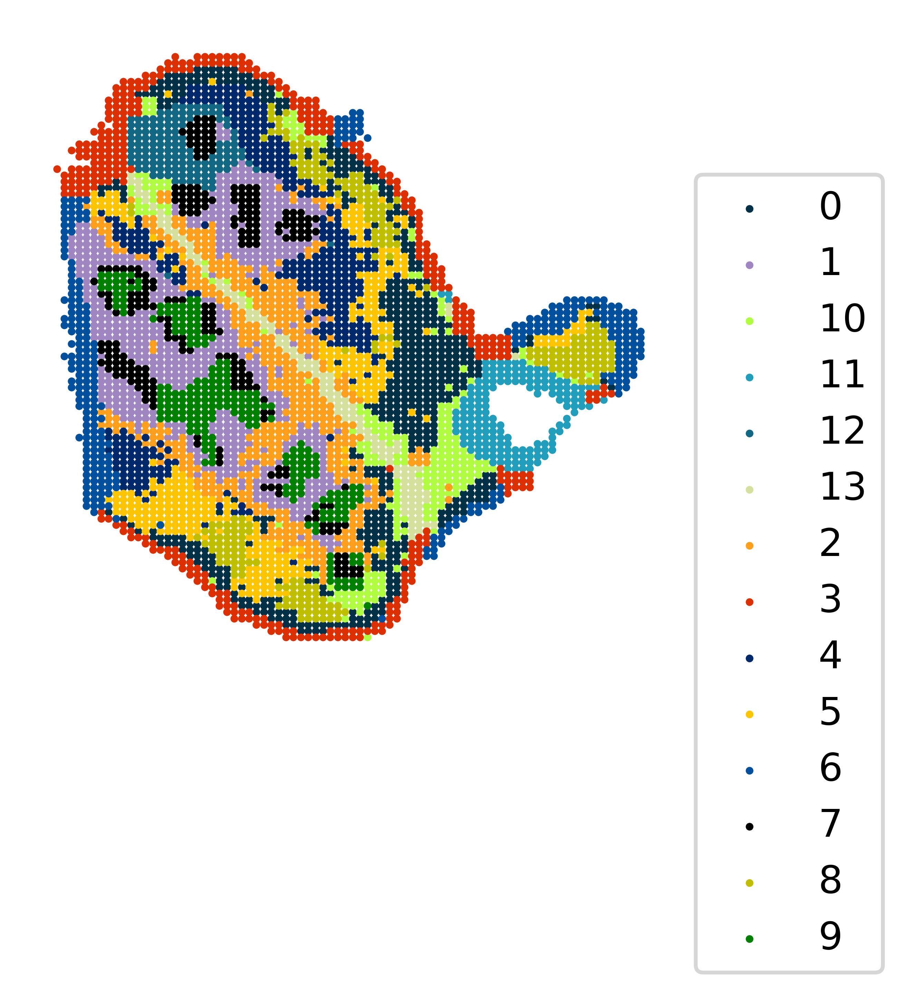

In [139]:
color_list = [
  
'#023047',
'#9f86c0',                                   
   '#affc41', 
'#219ebc',
'#126782',
  '#d4e09b',
'#ff9f1c',

'#dc2f02',
'#00296b',  
    '#fdc500',
'#00509d', 
    
'k',
    'y',
    'g',                                             

'#ffc9b9',   
'#8ecae6',
]
fig, ax = plt.subplots(1,1,figsize=(3,3),dpi=800)
for j,i in enumerate(sorted(adata_model_gener_reindexed.obs['cluster'].unique())):
    print(i)
    plt.scatter(adata_model_gener_reindexed.obsm['spatial'][adata_model_gener_reindexed.obs['cluster']==i,0],
                adata_model_gener_reindexed.obsm['spatial'][adata_model_gener_reindexed.obs['cluster']==i,1],
                s=1,
                color = color_list[j]
               )
plt.legend(sorted(adata_cluster.obs['cluster'].unique()),bbox_to_anchor=(1.01,0.8))
plt.axis('off') 
plt.gca().invert_yaxis()

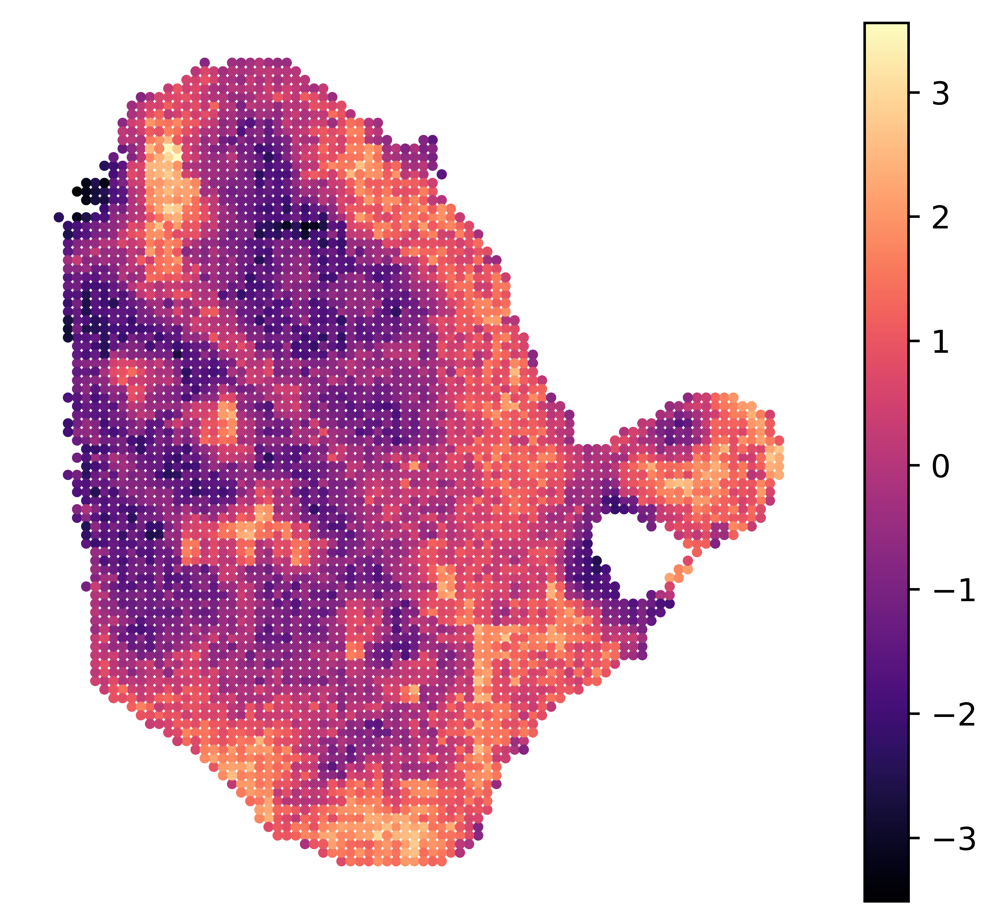

In [181]:
plt.subplots(1,1,figsize= (5.6,5),dpi=800)
g=plt.scatter(adata_model_gener_reindexed.obsm['spatial'][:,0],
            adata_model_gener_reindexed.obsm['spatial'][:,1],
            s=5,
            alpha = 1,
            c = adata_model_gener_reindexed.obsm['v_values'],
            cmap='magma'
           )
plt.colorbar(g)
#plt.legend(adata.obs['annotation'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.xlabel('')
plt.gca().invert_yaxis()

In [182]:
from collections import defaultdict

def average_attention_weights_for_unique_edges(edges_all, attn_weights_all):
    """
    Average attention weights for unique edges.
    
    Parameters:
    - edges_all: numpy array of shape (2, num_edges) representing all edge indices.
    - attn_weights_all: numpy array of shape (num_edges, num_heads) representing attention weights.
    
    Returns:
    - unique_edges: numpy array of shape (2, num_unique_edges) with unique edge indices.
    - averaged_weights: numpy array of shape (num_unique_edges,) with averaged attention weights.
    """
    edge_dict = defaultdict(list)
    
    # Convert edges to tuples to handle undirected edges (min, max)
    for i, (src, dst) in enumerate(edges_all.T):
        edge = tuple(sorted((src, dst)))
        edge_dict[edge].append(np.mean(attn_weights_all[i]))
    
    # Compute average attention weights for unique edges
    unique_edges = np.array(list(edge_dict.keys())).T
    averaged_weights = np.array([np.mean(weights) for weights in edge_dict.values()])
    
    return unique_edges, averaged_weights

In [183]:
unique_edges, averaged_weights = average_attention_weights_for_unique_edges(edges_all, attn_weights_all)


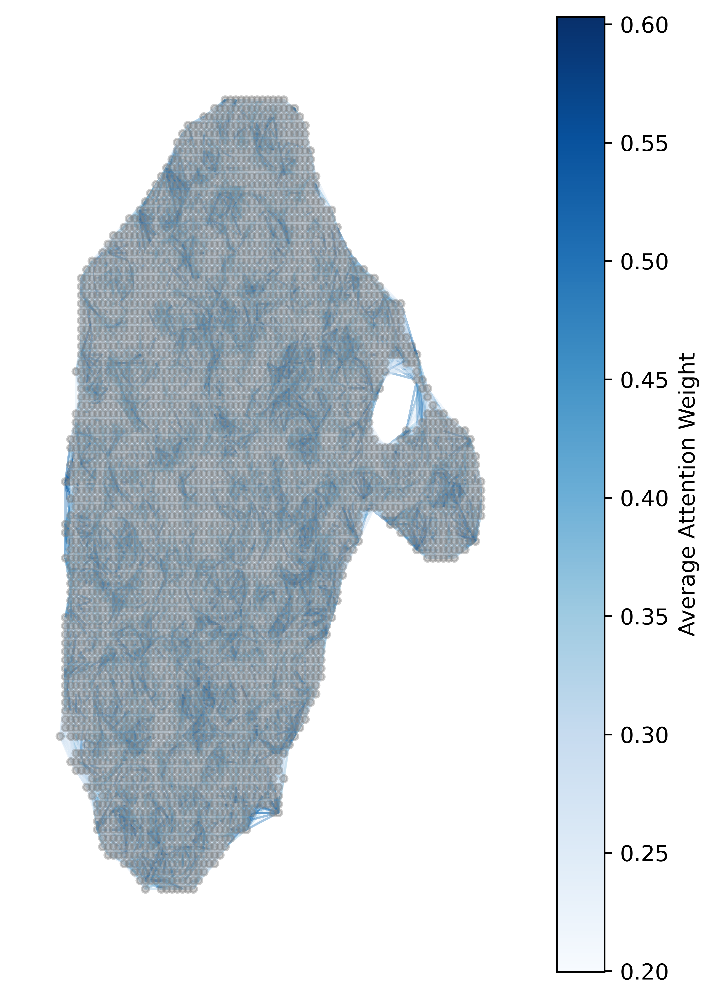

In [143]:
import networkx as nx
from torch_geometric.utils import to_networkx

def visualize_attention_graph_with_spatial_locations(unique_edges, averaged_weights, locations):
    """
    Visualize the graph with edge weights representing the average attention weights,
    using the real spatial locations for node positions.
    
    Parameters:
    - unique_edges: numpy array of shape (2, num_unique_edges) representing all unique edge indices.
    - averaged_weights: numpy array of shape (num_unique_edges,) representing averaged attention weights.
    - locations: numpy array of shape (num_nodes, 2) representing the spatial coordinates of each node.
    """
    G = nx.Graph()
    
    # Add edges with averaged attention weights as edge attributes
    for i, (src, dst) in enumerate(unique_edges.T):
        G.add_edge(src, dst, weight=averaged_weights[i])
    
    # Use the real spatial locations as node positions
    pos = {i: locations[i] for i in range(len(locations))}
    
    # Extract edge weights for visualization
    weights = [G[u][v]['weight'] for u, v in G.edges()]
    
    # Draw the graph
    plt.figure(figsize=(4,6),dpi=800)
    edges = nx.draw(G, pos, with_labels=False, node_size=10, node_color='gray',
                    edge_color=weights, edge_cmap=plt.cm.Blues, width=1, alpha=0.4)
    
    # Add a colorbar linked to the edges
    sm = plt.cm.ScalarMappable(cmap=plt.cm.Blues, norm=plt.Normalize(vmin=min(weights), vmax=max(weights)))
    sm.set_array([])
    plt.colorbar(sm, ax=plt.gca(), label='Average Attention Weight')
    
    #plt.title("Graph Visualization with Average Attention Weights and Spatial Locations")
    plt.show()

visualize_attention_graph_with_spatial_locations(unique_edges, averaged_weights, adata_model_gener_reindexed.obsm['spatial'])


In [144]:

def calculate_avg_weight_per_cell_type(unique_edges, averaged_weights, annotated_types):
    
    cell_type_pairs = defaultdict(list)
    
    # Create a set of all unique cell types
    unique_cell_types = sorted(annotated_types.unique())
    
    # Initialize a DataFrame with cell types as both rows and columns, filled with NaN
    df_avg_weights = pd.DataFrame(index=unique_cell_types, columns=unique_cell_types, dtype=float)
    
    cell_type_counts = annotated_types.value_counts()
    
    for i in range(unique_edges.shape[1]):
        src, dst = unique_edges[:, i]
        
        
        src_cell_type = annotated_types.iloc[src]
        
        dst_cell_type = annotated_types.iloc[dst]
        
        # Sort the cell types to treat (A, B) and (B, A) as the same pair
        cell_type_pair = tuple(sorted((src_cell_type, dst_cell_type)))
        
        weight = averaged_weights[i] * (cell_type_counts[src_cell_type] + cell_type_counts[dst_cell_type]) / 2
        
        cell_type_pairs[cell_type_pair].append(weight)
    
    # Calculate the average weight for each cell type pair and populate the DataFrame
    for pair, weights in cell_type_pairs.items():
        avg_weight = np.mean(weights)
        df_avg_weights.at[pair[0], pair[1]] = avg_weight
        df_avg_weights.at[pair[1], pair[0]] = avg_weight  # Symmetric matrix

    df_avg_weights.fillna(0, inplace=True)
    
    return df_avg_weights

# Example usage:
df_avg_weights = calculate_avg_weight_per_cell_type(unique_edges, averaged_weights, adata_model_gener_reindexed.obs['ground_type'])
df_avg_weights = df_avg_weights

In [145]:
new_order = [
    'Connective tissue capsule (fibroblast, RBC, myeloid)',
    'Outer cortex region 3 (DN T, DP T,cTEC)',
    'Middle cortex region 2 (DN T, DP T,cTEC)',
    'Medulla (SP T, mTEC, DC)',
    'Subcapsular zone (DN T)',
    'Inner cortex region 1 (DN T, DP T, cTEC)',
    'Connective tissue capsule (fibroblast)',
    'Corticomedullary junction (CMJ)'
]
# Reorder the DataFrame according to the specified order
df_avg_weights = df_avg_weights.reindex(new_order)

df_avg_weights = df_avg_weights[new_order]

In [146]:
df_avg_weights

,"Connective tissue capsule (fibroblast, RBC, myeloid)","Outer cortex region 3 (DN T, DP T,cTEC)","Middle cortex region 2 (DN T, DP T,cTEC)","Medulla (SP T, mTEC, DC)",Subcapsular zone (DN T),"Inner cortex region 1 (DN T, DP T, cTEC)",Connective tissue capsule (fibroblast),Corticomedullary junction (CMJ)
"Connective tissue capsule (fibroblast, RBC, myeloid)",121.906589,336.742462,149.837201,178.244468,122.752348,152.275773,113.754866,119.999823
"Outer cortex region 3 (DN T, DP T,cTEC)",336.742462,553.683297,361.634105,328.929005,337.683467,357.184993,330.783071,336.165658
"Middle cortex region 2 (DN T, DP T,cTEC)",149.837201,361.634105,178.631520,163.115503,150.805335,175.970141,147.621157,141.144362
"Medulla (SP T, mTEC, DC)",178.244468,328.929005,163.115503,149.100691,140.644455,160.499467,143.403360,128.335529
Subcapsular zone (DN T),122.752348,337.683467,150.805335,140.644455,125.380021,143.573014,119.042373,115.886905
"Inner cortex region 1 (DN T, DP T, cTEC)",152.275773,357.184993,175.970141,160.499467,143.573014,172.839634,135.730959,137.646834
Connective tissue capsule (fibroblast),113.754866,330.783071,147.621157,143.403360,119.042373,135.730959,111.448397,117.450215
Corticomedullary junction (CMJ),119.999823,336.165658,141.144362,128.335529,115.886905,137.646834,117.450215,101.306879


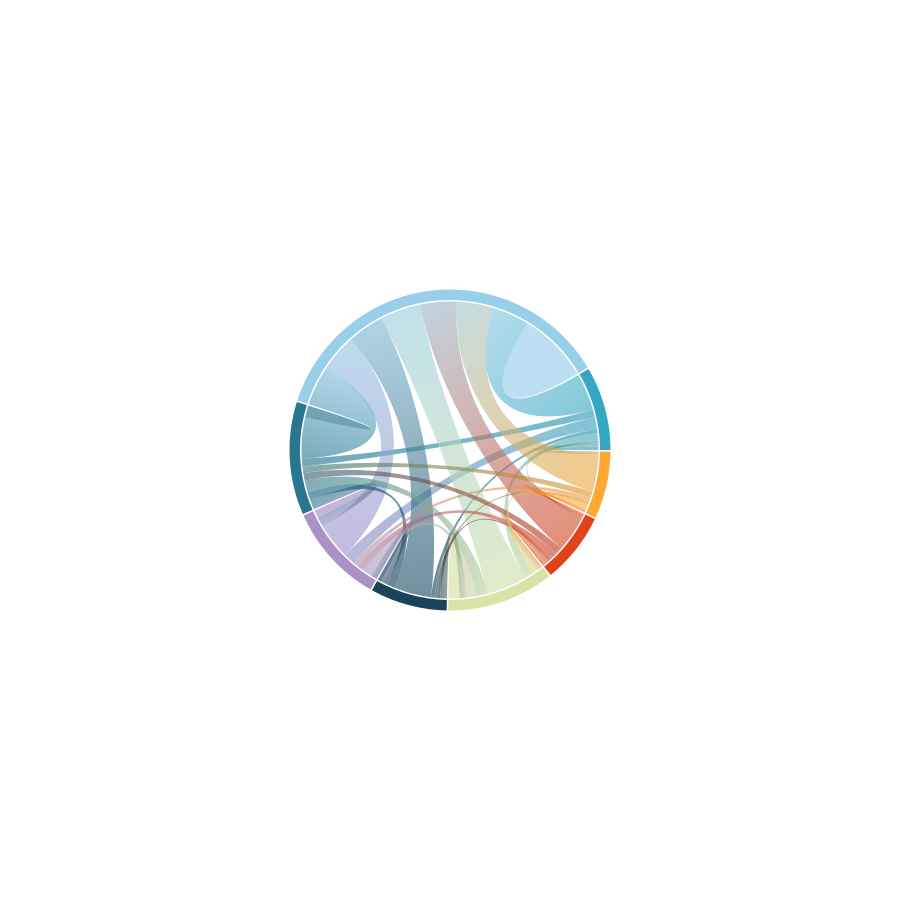

In [147]:
import openchord as ocd


matrix = ((df_avg_weights-100)/100).values.tolist()
names = df_avg_weights.index.tolist()
fig = ocd.Chord(matrix, names)

fig.colormap = [ '#219ebc',
'#8ecae6',
'#126782',
'#9f86c0', 
'#023047',                                  
'#d4e09b', 
'#dc2f02',
'#ff9f1c',


'#dc2f02',
'#9d0208',
'#f08080',
'#f94144',
'#f3722c',
'#f8961e',
'#f9c74f',
'#90be6d',
'#43aa8b',
'#577590',  
'#226CE0',
'#534B62'
                 ]
fig.font_size =0 
fig.radius = 150
fig.padding = 300
fig.show()

In [184]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

annotation_column = 'leiden'  # Replace with the actual name of your annotation column

# Step 1: Bin the qv values into equal-width bins
adata_model_gener_reindexed.obs['qv_bin'] = pd.qcut(adata_model_gener_reindexed.obsm['v_values'].flatten(), q=20)  # Adjust q for the number of bins

# Step 2: Calculate the percentage of each annotation in each bin
percentage_df = (
    adata_model_gener_reindexed.obs.groupby(['qv_bin', annotation_column])
    .size()
    .reset_index(name='count')
    .pivot(index='qv_bin', columns=annotation_column, values='count')
)

percentage_df = percentage_df.div(percentage_df.sum(axis=1), axis=0) * 100


color_mapping = {
  
'0':'#9f86c0',
'1':'#d4e09b',                                   
'2':'#219ebc', 
'3':'#126782',
'4':'#023047',
'5':'#ffc9b9',
'6':'#affc41',

'7':'y',
'8':'k',  
'9':'g',
'10':'#ff9f1c', 
    
'11':'#fdc500',
'12':'#00509d',
'13':'#8ecae6',                                             

'14':'#dc2f02',   
'15':'#00296b',
}


/tmp/ipykernel_3135318/1389354906.py:8: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_model_gener_reindexed.obs['qv_bin'] = pd.qcut(adata_model_gener_reindexed.obsm['v_values'].flatten(), q=20)  # Adjust q for the number of bins
/tmp/ipykernel_3135318/1389354906.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_model_gener_reindexed.obs.groupby(['qv_bin', annotation_column])


In [185]:
import matplotlib as mpl
# Set the font family to DejaVuSans or another font with full sentence support
mpl.rcParams['pdf.fonttype'] = 42  # Ensures text is stored as Type 3 font (OpenType)
mpl.rcParams['ps.fonttype'] = 42  # PostScript font type for compatibility


In [186]:
percentage_df.columns

CategoricalIndex(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11',
                  '12', '13', '14'],
                 categories=['0', '1', '2', '3', ..., '11', '12', '13', '14'], ordered=False, dtype='category', name='leiden')

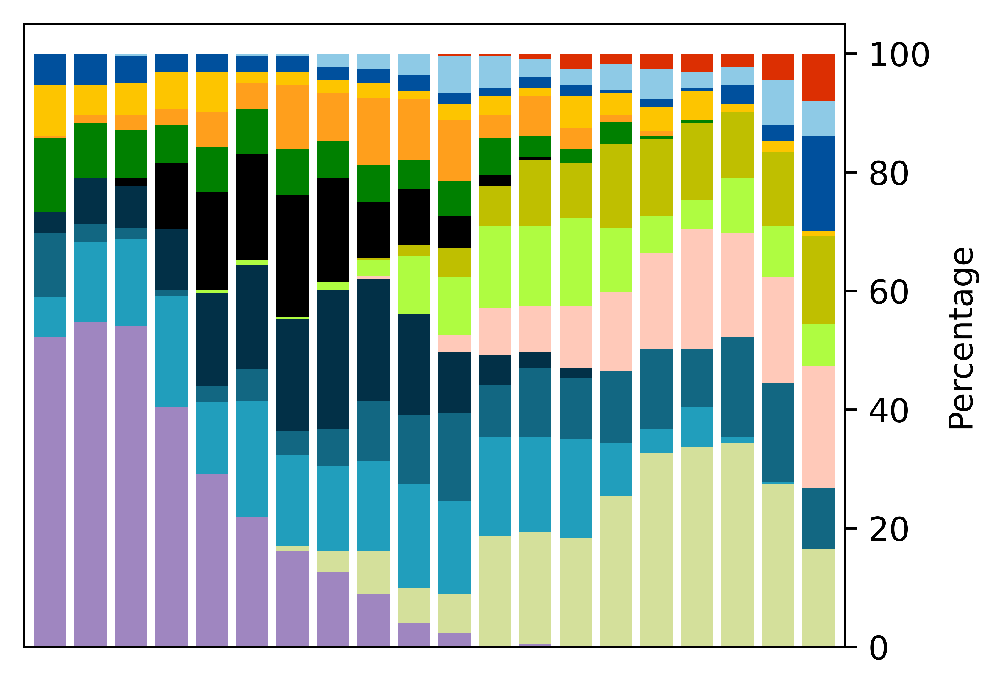

In [187]:
fig, ax = plt.subplots(figsize=(4.3, 3), dpi=800)

# Plot the data
percentage_df.plot(kind='bar', stacked=True, color=[color_mapping[col] for col in percentage_df.columns], width=0.8, ax=ax)

# Move y-axis to the right
ax.yaxis.set_label_position("right")
ax.yaxis.tick_right()

# Customize the plot
plt.title('')
ax.set_xlabel('')
ax.set_ylabel('Percentage')
plt.legend(title='Annotation', bbox_to_anchor=(1.3, 1), loc='upper left')
plt.xticks([])
plt.legend([], [], frameon=False)

plt.tight_layout()

plt.savefig('../figure/fig4f.pdf',dpi=600)

In [105]:
adata_model_gener_reindexed

AnnData object with n_obs × n_vars = 4468 × 51
    obs: 'sc_leiden', 'ground_type'
    obsm: 'generated_expr', 'coral', 'spatial', 'visium_true', 'codex_true', 'v_values', 'cell_types', 'sc_inte_umap'

In [190]:
sc_adata = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/fig4/visium_adata_r1.h5ad')
generated_expr_adata = anndata.AnnData(
    adata_model_gener_reindexed.obsm['generated_expr']
)
generated_expr_adata.var_names = sc_adata.var_names
generated_expr_adata.obs['qv_bin'] = adata_model_gener_reindexed.obs['qv_bin'].astype('str').astype('category').values


generated_expr_adata.layers["scaled"] = sc.pp.scale(generated_expr_adata, copy=True).X
#sc.pp.normalize_total(generated_expr_adata, target_sum=1e4)
sc.pp.log1p(generated_expr_adata)
# Perform differential expression analysis
sc.tl.rank_genes_groups(generated_expr_adata, groupby='qv_bin', method='wilcoxon')

desired_order = list(percentage_df.index.astype('str')) # Replace with your specific group order
generated_expr_adata.obs['qv_bin'] = generated_expr_adata.obs['qv_bin'].cat.reorder_categories(desired_order, ordered=True)
generated_expr_adata.obs['qv_bin'].cat.set_categories(desired_order, ordered=True)

#new_categories = [str(i+1) for i in range(len(generated_expr_adata.obs['qv_bin'].cat.categories))]

# Map the old categories to the new labels
#generated_expr_adata.obs['qv_bin'] = generated_expr_adata.obs['qv_bin'].cat.rename_categories(new_categories)



0       (-1.237, -1.026]
1         (0.676, 0.852]
2         (1.873, 3.559]
3         (0.328, 0.492]
4         (0.676, 0.852]
              ...       
4463    (-0.847, -0.681]
4464    (-0.681, -0.525]
4465    (-0.0207, 0.149]
4466      (1.873, 3.559]
4467      (0.149, 0.328]
Name: qv_bin, Length: 4468, dtype: category
Categories (20, object): ['(-3.5109999999999997, -1.739]' < '(-1.739, -1.466]' < '(-1.466, -1.237]' < '(-1.237, -1.026]' ... '(1.042, 1.271]' < '(1.271, 1.532]' < '(1.532, 1.873]' < '(1.873, 3.559]']

In [212]:


import scanpy as sc
import numpy as np
sc.set_figure_params(dpi=800, color_map="viridis_r")
sc.settings.verbosity = 0
sc.logging.print_header()
# Step 1: Run the differential expression analysis
sc.tl.rank_genes_groups(generated_expr_adata, groupby='qv_bin', method='wilcoxon')

# Step 2: Extract top genes for each group in the specified order
top_genes = []
for group in desired_order:
    genes = generated_expr_adata.uns['rank_genes_groups']['names'][group][:3]  # Top 3 genes per group
    top_genes.extend(genes)

# Step 3: Plot the heatmap with genes in the correct order
sc.pl.heatmap(
    generated_expr_adata,
    var_names=top_genes,
    groupby='qv_bin',
    use_raw=False,
    swap_axes=True,
    vmin=-1,
    vmax=1,
    cmap="magma",
    layer="scaled",
    figsize=(5.5, 4),
    show=False
)
# Step 4: Save the heatmap as a PDF
plt.savefig("../figure/fig4h.pdf", format="pdf", bbox_inches="tight")
plt.close()  # Close the figure to free up memory

scanpy==1.10.1 anndata==0.10.7 umap==0.5.6 numpy==1.26.0 scipy==1.13.0 pandas==2.2.3 scikit-learn==1.5.0 statsmodels==0.14.2 igraph==0.11.5 pynndescent==0.5.12


In [208]:
visium_adata.var_names.values[[int(i) for i in top_genes]]

array(['Rimbp2', 'Otop2', 'Slc7a14', 'Gm7538', 'Adam34', 'Slc7a14',
       'Gm49352', 'B130006D01Rik', 'Gm16193', 'Gm16193', 'Gm49352',
       'Rimbp2', 'Gm16193', 'Gm49352', 'Kank4', 'Rimbp2', 'Slc13a3',
       'Alb', 'Fgf9', 'Atf7ip2', 'Slc13a3', 'Arrdc5', 'Gm37202',
       'Ccdc177', 'Gm37202', 'Cadm4', 'Atf7ip2', '1700094J05Rik',
       'Gm37202', 'Lrrc23', 'Lrrc23', 'Cadm4', 'A430090L17Rik', 'Kptn',
       'Gper1', 'Lrrc23', 'Kptn', 'D2hgdh', 'Rpl13a-ps1', 'Aipl1',
       'Ift43', 'Gm17089', 'Cd244', 'Ntpcr', 'Acbd7', 'Ntpcr',
       'AC034116.3', 'Sdhb', 'Acbd7', 'Ankzf1', 'Dctn5', 'Dctn5',
       '4930445B16Rik', 'Ntpcr', 'Cpsf1', 'mt-Nd6', 'Ola1', 'Cpsf1',
       'Mrps11', 'Caml'], dtype=object)

In [209]:
generated_expr_adata.uns['rank_genes_groups']['names'][group]

array(['972', '2477', '734', ..., '1635', '2458', '717'], dtype=object)

In [293]:
from scipy.ndimage.filters import gaussian_filter1d
def plot_onco_path_traj(plot_type,_filtered,ylim_l,ylim_r, adata_scRNA,file_):
    data = pd.DataFrame(np.linspace(adata_scRNA.obsm['v_values'].min(),adata_scRNA.obsm['v_values'].max(),200),columns=['time'])
    data_mean_ = []
    data_std_ = []

    colors_ = "#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])

    for i in range(200):

        if i>0:
            temp_ = adata_scRNA.to_df().loc[:,_filtered][(adata_scRNA.obsm['v_values']<=data['time'][i])&
                                                        (adata_scRNA.obsm['v_values']>=data['time'][i-1])
                                                       ].mean(axis=1)
            if len(temp_)>0:
                data_mean_.append(temp_.mean())
                if np.isnan(temp_.std()):
                    data_std_.append(data_std_[-1])
                else:
                    data_std_.append(temp_.std())
            else:
                data_mean_.append(data_mean_[-1])
                data_std_.append(data_std_[-1])
        else:
            data_mean_.append(0)
            data_std_.append(0)

    data_mean_[0] = data_mean_[1]
    data_std_[0] = data_std_[1]
    data['mean'] = data_mean_
    data['std'] = data_std_
    #print(data)
    
    sns.set(style="darkgrid", palette="muted", color_codes=True)
    fig, ax = plt.subplots(figsize=(2.5,1),dpi=900)

    # Smoothing
    Final_array_smooth = gaussian_filter1d(data['mean'], sigma=4)

    # Error formating
    upper_err = gaussian_filter1d(data['mean'] + (data['std']), sigma=10)
    lower_err = gaussian_filter1d(data['mean'] - (data['std']), sigma=10)

    ax.plot(data['time'], data['mean'], '--', linewidth=0.7, color='k', alpha=0.45)

    ax.plot(data['time'], Final_array_smooth,c=colors_)

    ax.fill_between(data['time'], upper_err, lower_err, color=colors_, alpha=0.2)

    ax.set_ylim(np.min(data['mean'])-(np.min((data['mean'])*30)/100), np.max(data['mean'])+(np.max((data['mean'])*30)/100))
    ax.set_ylim([ylim_l,ylim_r])
    #ax.set_xlim([0,1])
    ax.set_xticks([])
    #ax.set_xlabel('Pseudo-time')
    #ax.set_ylabel('Averaged scaled expression')
    plt.tight_layout()

    plt.savefig('../figure/'+file_,dpi=600)

/tmp/ipykernel_3135318/173989291.py:1: DeprecationWarning: Please import `gaussian_filter1d` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.filters import gaussian_filter1d


In [225]:
generated_expr_adata.obsm['v_values']=adata_model_gener_reindexed.obsm['v_values']
generated_expr_adata.var_names = visium_adata.var_names.values

In [263]:
generated_expr_adata.X = generated_expr_adata.layers['scaled']

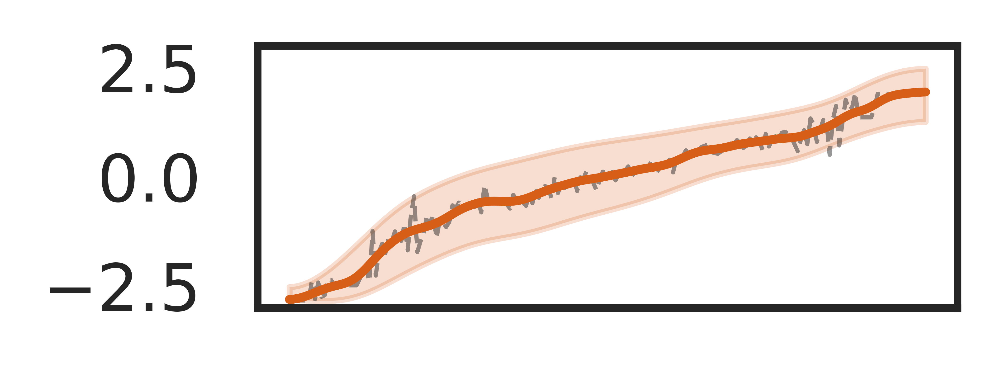

In [295]:
cd8_activation = [
'Cd3d', 'Cd3e', 'Cd4', 'Cd8a', 'Cd8b1'
]

gn_filtered = np.intersect1d(cd8_activation,generated_expr_adata.var_names)
plot_onco_path_traj('NOTCH',gn_filtered,-3,3,generated_expr_adata,'maturation.pdf')


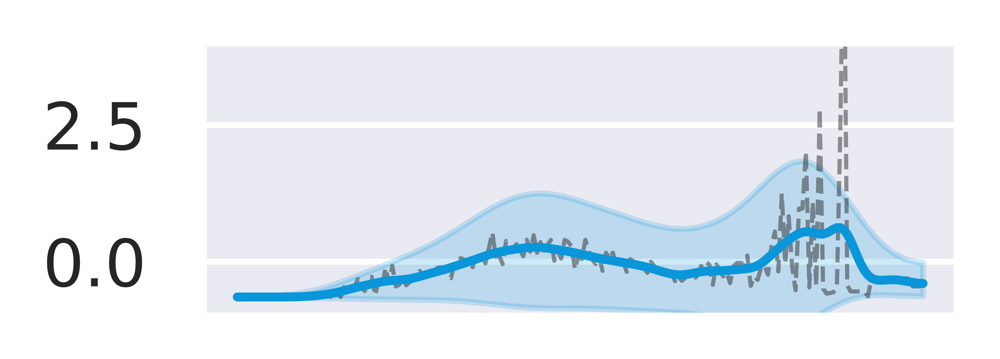

In [302]:
cd8_activation = [
 "Itgax", "Cd86", "Relb", "Batf3", ]

gn_filtered = np.intersect1d(cd8_activation,generated_expr_adata.var_names)
plot_onco_path_traj('NOTCH',gn_filtered,-1,4,generated_expr_adata,'Dendritic cell markers.pdf')


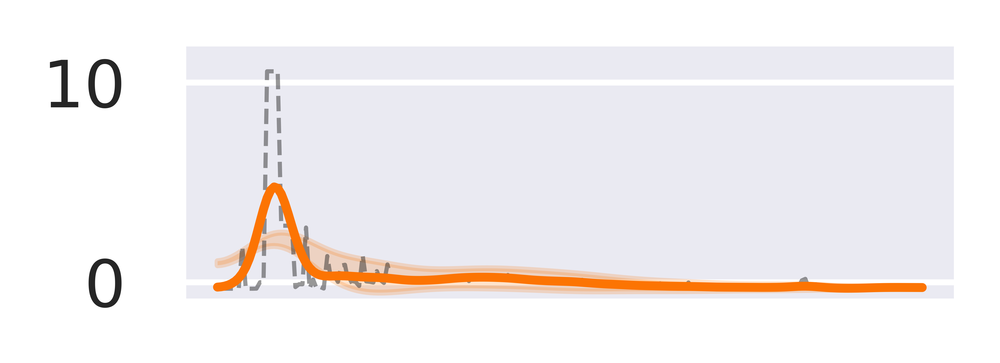

In [307]:
cd8_activation = [
    'Slc13a3','Alb','Fgf9']

gn_filtered = np.intersect1d(cd8_activation,generated_expr_adata.var_names)
plot_onco_path_traj('NOTCH',gn_filtered,-1,12,generated_expr_adata,'Medulla.pdf')
